# Instituto Tecnológico de Costa Rica | TEC
# Carrera de Ingeniería en Computación 
# I Semestre de 2023
# Proyecto Programado (II Fase – Entrevistador asistido por IA) 
# Dr. Abel Méndez Porras
#Estudiantes
#Daniela Rodríguez Méndez
#Sharon Dayana Blanco Piedra
# amendez@itcr.ac.cr
# Porcentaje: 20%

# Entrevistador asistido por IA



El reconocimiento facial y la detección de emociones son tecnologías que se han vuelto cada vez más populares en los últimos años. Estas tecnologías utilizan algoritmos de inteligencia artificial para analizar imágenes y detectar patrones faciales que permiten identificar a las personas y sus emociones.
En cuanto a las oportunidades, el reconocimiento facial puede tener aplicaciones en la seguridad, el marketing y la atención al cliente. Por ejemplo, en la seguridad se pueden utilizar sistemas de reconocimiento facial para identificar a personas en lugares públicos o para controlar el acceso a edificios y sistemas de seguridad. En el marketing, se pueden utilizar para personalizar la publicidad en función de la edad, el género y otros datos demográficos. Y en la atención al cliente, se pueden utilizar para detectar la satisfacción del cliente en tiempo real y responder adecuadamente.

En esta primera etapa del proyecto del curso de Taller de Programación estaremos utilizando los resultados de consultas a modelos de Deep Learning para aplicar los conocimientos adquiridos en clase. 

## Objetivo
Desarrollar una aplicación de complejidad baja que permita poner en práctica los conocimientos adquiridos en los cursos de Introducción a la Programación y Taller de Programación.

## Objetivos Específicos
*  Identificar los requerimientos para resolver un problema específico desde la perspectiva de resolución de problemas, técnicas con listas, diccionarios, clases, objetos y archivos.
*  Diseñar una aplicación para un problema específico desde la perspectiva de resolución de problemas, técnicas con listas, diccionarios, clases, objetos y archivos.
*  Desarrollar una aplicación para un problema específico desde la perspectiva de resolución de problemas, técnicas con listas, diccionarios, clases, objetos y archivos.

## Configuración previa 

### Cargar Google Drive

In [44]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Leer cámara
Tomado de https://colab.research.google.com/drive/1QnC7lV7oVFk5OZCm75fqbLAfD9qBy9bw?usp=sharing#scrollTo=ilLkpcKanPRb



### Importar dependencies

In [ ]:
# import dependencies
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import io
import html
import time

### Convertir el objeto JavaScript un objeto OpenCV image

In [ ]:
# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

### Crear nuestro live video stream

In [ ]:
# JavaScript to properly create our live video stream using our webcam as input
def video_stream():
  js = Javascript('''
    var video;
    var div = null;
    var stream;
    var captureCanvas;
    var imgElement;
    var labelElement;
    
    var pendingResolve = null;
    var shutdown = false;
    
    function removeDom() {
       stream.getVideoTracks()[0].stop();
       video.remove();
       div.remove();
       video = null;
       div = null;
       stream = null;
       imgElement = null;
       captureCanvas = null;
       labelElement = null;
    }
    
    function onAnimationFrame() {
      if (!shutdown) {
        window.requestAnimationFrame(onAnimationFrame);
      }
      if (pendingResolve) {
        var result = "";
        if (!shutdown) {
          captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
          result = captureCanvas.toDataURL('image/jpeg', 0.8)
        }
        var lp = pendingResolve;
        pendingResolve = null;
        lp(result);
      }
    }
    
    async function createDom() {
      if (div !== null) {
        return stream;
      }

      div = document.createElement('div');
      div.style.border = '2px solid black';
      div.style.padding = '3px';
      div.style.width = '100%';
      div.style.maxWidth = '600px';
      document.body.appendChild(div);
      
      const modelOut = document.createElement('div');
      modelOut.innerHTML = "<span>Status:</span>";
      labelElement = document.createElement('span');
      labelElement.innerText = 'No data';
      labelElement.style.fontWeight = 'bold';
      modelOut.appendChild(labelElement);
      div.appendChild(modelOut);
           
      video = document.createElement('video');
      video.style.display = 'block';
      video.width = div.clientWidth - 6;
      video.setAttribute('playsinline', '');
      video.onclick = () => { shutdown = true; };
      stream = await navigator.mediaDevices.getUserMedia(
          {video: { facingMode: "environment"}});
      div.appendChild(video);

      imgElement = document.createElement('img');
      imgElement.style.position = 'absolute';
      imgElement.style.zIndex = 1;
      imgElement.onclick = () => { shutdown = true; };
      div.appendChild(imgElement);
      
      const instruction = document.createElement('div');
      instruction.innerHTML = 
          '<span style="color: red; font-weight: bold;">' +
          'When finished, click here or on the video to stop this demo</span>';
      div.appendChild(instruction);
      instruction.onclick = () => { shutdown = true; };
      
      video.srcObject = stream;
      await video.play();

      captureCanvas = document.createElement('canvas');
      captureCanvas.width = 640; //video.videoWidth;
      captureCanvas.height = 480; //video.videoHeight;
      window.requestAnimationFrame(onAnimationFrame);
      
      return stream;
    }
    async function stream_frame(label, imgData) {
      if (shutdown) {
        removeDom();
        shutdown = false;
        return '';
      }

      var preCreate = Date.now();
      stream = await createDom();
      
      var preShow = Date.now();
      if (label != "") {
        labelElement.innerHTML = label;
      }
            
      if (imgData != "") {
        var videoRect = video.getClientRects()[0];
        imgElement.style.top = videoRect.top + "px";
        imgElement.style.left = videoRect.left + "px";
        imgElement.style.width = videoRect.width + "px";
        imgElement.style.height = videoRect.height + "px";
        imgElement.src = imgData;
      }
      
      var preCapture = Date.now();
      var result = await new Promise(function(resolve, reject) {
        pendingResolve = resolve;
      });
      shutdown = false;
      
      return {'create': preShow - preCreate, 
              'show': preCapture - preShow, 
              'capture': Date.now() - preCapture,
              'img': result};
    }
    ''')

  display(js)
  
def video_frame(label, bbox):
  data = eval_js('stream_frame("{}", "{}")'.format(label, bbox))
  return data

### Iniciar streaming video

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont

In [ ]:
import cv2
import numpy as np
import tensorflow as tf
from keras.models import model_from_json

### Cargar modelos de Deep Learning entrenados

*   Para detectar los rostros se utiliza el modelo de Face Haar Cascade.
*   Para detectar las emociones se utiliza el modelo de VGG.
*   También se utiliza un algoritmo adicional para pasar la información del algortimo de VGG a un formato JSON.

Estos modelos y algoritmos están disponibles en el siguiente enlace [Descargar modelos y algoritmos](https://drive.google.com/drive/folders/1KctA_s25bqqMOUlQuy0lwTm0HkBGVycF?usp=sharing). Usted los debe colocar en su Google Drive y modificar la ruta de acceso. 



In [ ]:
#Cargar modelos de Deep Learning entrenados
face_haar_cascade = cv2.CascadeClassifier('/content/drive/MyDrive/Images/haarcascade_frontalface_alt (1).xml') 
model = model_from_json(open("/content/drive/MyDrive/Images/model (2).json", "r").read()) 
model.load_weights('/content/drive/MyDrive/Images/model (1).h5') 


Crear interfaz
https://www.youtube.com/watch?v=oIVmV41uyK8

#Perfiles del Entrevistador Personal

El entrevistador personal es una herramienta para recolectar información de personas que están aplicando a un puesto. En la aplicación existen tres perfiles el entrevistador, el entrevistado y el evaluador. La información de estos perfiles debe ser almacenada en clases y usando herencia. Debe existir una clase "padre" que tiene propiedades y métodos que comparten todos los perfiles. Para cada perfil debe existir una clase subordinada que hereda las propiedades de la clase "padre", además, tiene sus propias propiedades y métodos.

In [ ]:
def show_image(image_path):
  """ This function shows an image.
    Arguments:
        image_path {str} -- Image path. 
  """
  img = cv2.imread(image_path)
  img_cvt=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  plt.imshow(img_cvt)
  plt.show()
#Code taken from ordenamientos de "Reconocimiento de Personas" in week 8 of Introducción a la Programación.

In [ ]:
class Person():
  def __init__(self, identification, name, birth_date, age, nationality, telephone_numbers, gender, emails, address):
    """Forms a instance of a person"""
    self.name = name
    self.identification = identification
    self.birth_date = birth_date
    self.age = age
    self.nationality = nationality
    self.telephone_numbers = telephone_numbers 
    self.gender = gender
    self.emails = emails
    self.address = address

class Interviewer(Person):
  """Forms a instance of an interviewer and enherits the class named Person"""
  def __init__(self, identification, name, birth_date, age, nationality, telephone_numbers, gender, emails, address, code_number, certificate, experience):
   super().__init__(identification, name, birth_date, age, nationality, telephone_numbers, gender, emails, address)
   self.code_number = code_number
   self.certificate = certificate
   self.experience = experience
  def __str__(self):
    """This method is for printing the instance information"""
    return f"name: {self.name}, identitification: {self.identification}, birth_date: {self.birth_date}, age: {self.age}, nationality: {self.nationality}, telephone_numbers: {self.telephone_numbers}, gender: {self.gender}, emails: {self.emails}, address: {self.address}, code_number: {self.code_number}, certificate: {self.certificate}, experience: {self.experience}"



class Evaluator(Person):
  def __init__(self, identification, name, birth_date, age, nationality, telephone_numbers, gender, emails, address, specialty, technical_programs, languages):
   """Forms a instance of an evaluator and enherits the class named Person"""
   super().__init__(identification, name, birth_date, age, nationality, telephone_numbers, gender, emails, address)
   self.specialty = specialty
   self.technical_programs = technical_programs
   self.languages = languages
  def __str__(self):
    """This method is for printing the instance information"""
    return f"name: {self.name}, identitification: {self.identification}, birth_date: {self.birth_date}, age: {self.age}, nationality: {self.nationality}, telephone_numbers: {self.telephone_numbers}, gender: {self.gender}, emails: {self.emails}, address: {self.address}, specialty: {self.specialty}, technical_programs: {self.technical_programs}, languages: {self.languages}"





class Interviewee(Person):
  def __init__(self, identification, name, birth_date, age, nationality, telefone_numbers, gender, emails, address, marital_status, children, job, salary, academic_grade, state, images):
   """Forms a instance of an interviewee and enherits the class named Person"""
   super().__init__(identification, name, birth_date, age, nationality, telefone_numbers, gender, emails, address)
   self.marital_status = marital_status
   self.children = children
   self.job = job
   self.salary = salary
   self.academic_grade = academic_grade
   self.state = state
   self.images = images
  def __str__(self):
    """This method is for printing the instance information"""
    return f"name: {self.name}, identitification: {self.identification}, birth_date: {self.birth_date}, age: {self.age}, nationality: {self.nationality}, telephone_numbers: {self.telephone_numbers}, gender: {self.gender}, emails: {self.emails}, address: {self.address}, marithal_status: {self.marital_status}, children: {self.children}, job: {self.job}, salary: {self.salary}, academic_grade: {self.academic_grade}, state: {self.state}, images: {self.images}"


## Recolectar información del entrevistador


El entrevistador es la persona encargada de realizar las entrevistas. 

Información requerida del entrevistador (Toda la información requerida debe ser almacenada en la clase Entrevistador. Cada vez que se registra un entrevistador se debe crear una instancia de la clase Entrevistador para guardar toda la información del entrevistador). 
*   Identificación  
*   Nombre 
*   Fecha de nacimiento
*   Nacionalidad
*   Números de teléfono y celular (un diccionario)
*   Emails (una lista con uno o varios emails)
*   Dirección

Usted debe incluir al menos tres propiedades únicas al entrevistador.
Cada vez que se crea una instancia de Entrevistador, la instancia debe ser almacenada en un archivo binario llamado Archivo_Entrevistador.

## Recolectar información del evaluador

El evaluador en la persona encargada de revisar la información obtenida de cada entrevista. 

Información requerida del evaluador (Toda la información requerida debe ser almacenada en la clase Evaluador. Cada vez que se registra un evaluador se debe crear una instancia de la clase Evaluador para guardar toda la información del evaluador). 
*   Identificación  
*   Nombre 
*   Fecha de nacimiento
*   Nacionalidad
*   Números de teléfono y celular (un diccionario)
*   Emails (una lista con uno o varios emails)
*   Dirección

Usted debe incluir al menos tres propiedades únicas al evaluador.
Cada vez que se crea una instancia de Evaluador, la instancia debe ser almacenada en un archivo binario llamado Archivo_Evaluador.

## Recolectar información del entrevistado

El entrevistado es la persona que está interesada en el puesto de trabajo.

Información requerida al entrevistar una persona (Toda la información requerida debe ser almacenada en la clase Entrevistado. Cada vez que se registra un entrevistado se debe crear una instancia de la clase Entrevistado para guardar toda la información del entrevistado).
*   Identificación  
*   Nombre 
*   Fecha de nacimiento
*   Nacionalidad
*   Números de teléfono y celular (un diccionario)
*   Emails (una lista con uno o varios emails)
*   Dirección
*   Estado civil
*   Cantidad de hijos indicando el género, la fecha de nacimiento(un diccionario) 
*   Entrevistas (cada persona puede ser entrevistada cero o más veces). Las entrevistas se realizan en tiempo real utilizando una camára integrada a la computadora o externa (el profesor facilita el código para activar la camára, capturar el video y capturar los frames cada cierto tiempo). Se debe crear una lista con sublistas donde cada sublista tiene las imagenes capturas y las emociones reportadas durante la entrevista. Además, debe guardar coordenadas donde se encuentra el rostro en la imagen. Para cada entrevista, el entrevistado debe contar historias cortas sobre los siguientes 4 tópicos:


  >*   Una experiencia de sorpresa o asombro que ha tenido que vivir.
  >*   Una experiencia de tristeza que ha tenido que vivir.
  >*   Una experiencia de enojo o frustración que ha tenido que vivir.
  >*   Una experiencia de felicidad que ha tenido que vivir.

Un aspecto importante es que cada vez que se va a realizar una entrevista se debe indicar quién es el entrevistador.

Usted debe incluir al menos tres propiedades únicas al perfil de entrevistado. Cada vez que se crea una instancia de Entrevistado, la instancia debe ser almacenada en un archivo binario llamado Archivo_Entrevistador.

### Recolectar información emociones
Este código se encarga de ejecutar la captura de video de la cámara, detectar los rostros en las imágenes y reconocer las emociones presentes en los rostros. Cuando se hace la entrevista es en este código donde usted de obtener la información para crear las listas con la información solicitada.

#Vaciar archivos binario y reiniciar número de el contador.

In [72]:
Evaluatorlist = []
Interviewerlist = []
Intervieweelist = []


In [73]:
a = 5

In [74]:
import pickle
with open("/content/drive/MyDrive/Binary_archive/Archivo_j", "wb") as entre:
      pickle.dump(a, entre)



In [75]:
with open("/content/drive/MyDrive/Binary_archive/Archivo_Evaluador", "wb") as entre:
      pickle.dump(Evaluatorlist, entre)
with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistador", "wb") as entre:
      pickle.dump(Interviewerlist, entre)
with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistado", "wb") as entre:
      pickle.dump(Intervieweelist, entre)

In [ ]:
with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistado", "wb") as entre:
      pickle.dump(Intervieweelist, entre)

#Tomar capturas de pantalla

<IPython.core.display.Javascript object>

Ubicación del rostro: [[193 220 128 128]]
1/1 [==============================] - 0s 60ms/step
Predicciones:  [[4.3732207e-04 7.0315396e-06 6.2518491e-04 9.8849082e-01 1.5406163e-03
  3.0959008e-04 8.5894624e-03]]
3 [4.3732207e-04 7.0315396e-06 6.2518491e-04 9.8849082e-01 1.5406163e-03
 3.0959008e-04 8.5894624e-03]
Predicciones:  {'angry': 0.00043732207, 'disgust': 7.0315396e-06, 'fear': 0.0006251849, 'happiness': 0.9884908, 'sadness': 0.0015406163, 'surprise': 0.00030959008, 'neutral': 0.008589462}
happyness


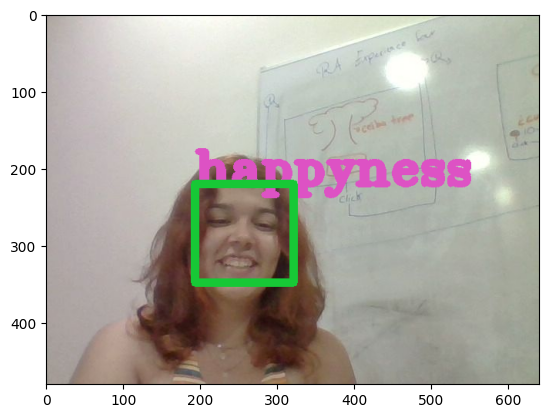

Ubicación del rostro: [[197 215 125 125]]
1/1 [==============================] - 0s 57ms/step
Predicciones:  [[0.02621076 0.00295916 0.05950241 0.7597421  0.11619791 0.00565498
  0.02973271]]
3 [0.02621076 0.00295916 0.05950241 0.7597421  0.11619791 0.00565498
 0.02973271]
Predicciones:  {'angry': 0.026210755, 'disgust': 0.0029591594, 'fear': 0.059502408, 'happiness': 0.7597421, 'sadness': 0.116197914, 'surprise': 0.0056549767, 'neutral': 0.029732708}
happyness


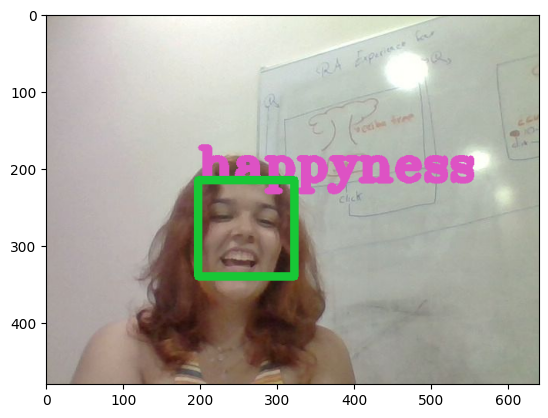

Ubicación del rostro: [[201 227 135 135]]
1/1 [==============================] - 0s 57ms/step
Predicciones:  [[1.1692893e-03 1.8147877e-05 1.4320682e-03 9.7723651e-01 2.5816308e-03
  9.0177485e-04 1.6660523e-02]]
3 [1.1692893e-03 1.8147877e-05 1.4320682e-03 9.7723651e-01 2.5816308e-03
 9.0177485e-04 1.6660523e-02]
Predicciones:  {'angry': 0.0011692893, 'disgust': 1.8147877e-05, 'fear': 0.0014320682, 'happiness': 0.9772365, 'sadness': 0.0025816308, 'surprise': 0.00090177485, 'neutral': 0.016660523}
happyness


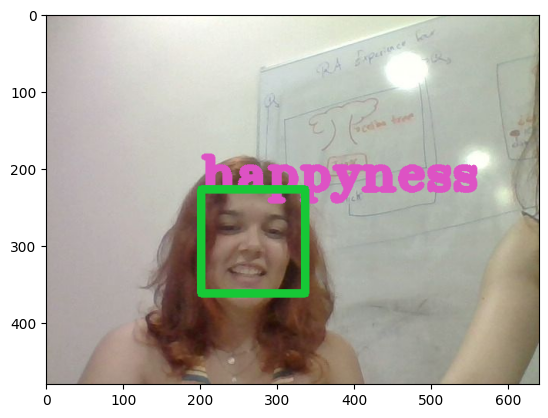

Ubicación del rostro: [[194 223 138 138]]
1/1 [==============================] - 0s 56ms/step
Predicciones:  [[3.1156572e-02 5.4216571e-04 2.3910880e-02 2.5622874e-01 8.1253253e-02
  4.6429653e-03 6.0226542e-01]]
6 [3.1156572e-02 5.4216571e-04 2.3910880e-02 2.5622874e-01 8.1253253e-02
 4.6429653e-03 6.0226542e-01]
Predicciones:  {'angry': 0.031156572, 'disgust': 0.0005421657, 'fear': 0.02391088, 'happiness': 0.25622874, 'sadness': 0.08125325, 'surprise': 0.0046429653, 'neutral': 0.6022654}
neutral


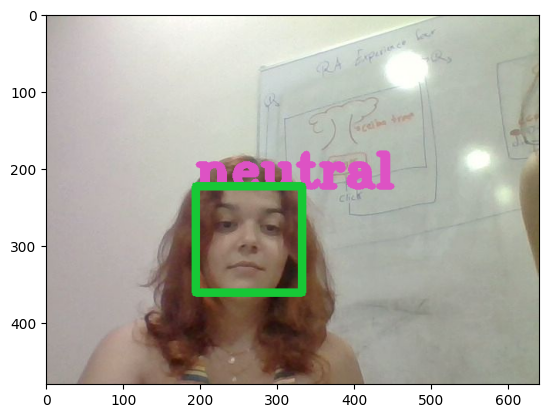

Ubicación del rostro: [[188 214 141 141]]
1/1 [==============================] - 0s 187ms/step
Predicciones:  [[4.7167469e-02 5.5534724e-04 3.7170239e-02 1.0898482e-01 1.3996193e-01
  3.1216219e-03 6.6303855e-01]]
6 [4.7167469e-02 5.5534724e-04 3.7170239e-02 1.0898482e-01 1.3996193e-01
 3.1216219e-03 6.6303855e-01]
Predicciones:  {'angry': 0.04716747, 'disgust': 0.00055534724, 'fear': 0.03717024, 'happiness': 0.10898482, 'sadness': 0.13996193, 'surprise': 0.003121622, 'neutral': 0.66303855}
neutral


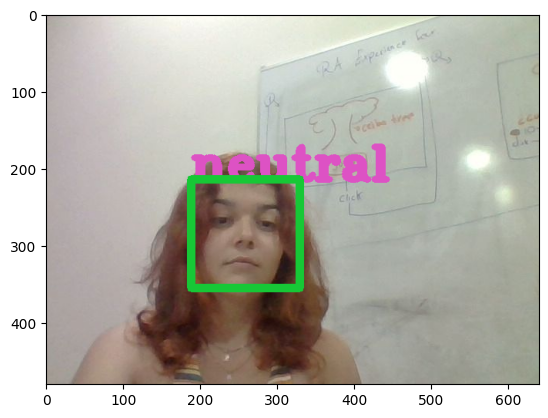

Ubicación del rostro: [[181 218 135 135]]
1/1 [==============================] - 0s 67ms/step
Predicciones:  [[0.07094956 0.00061972 0.09568904 0.0100841  0.3783751  0.00150233
  0.4427802 ]]
6 [0.07094956 0.00061972 0.09568904 0.0100841  0.3783751  0.00150233
 0.4427802 ]
Predicciones:  {'angry': 0.07094956, 'disgust': 0.0006197189, 'fear': 0.095689036, 'happiness': 0.010084095, 'sadness': 0.3783751, 'surprise': 0.0015023345, 'neutral': 0.4427802}
neutral


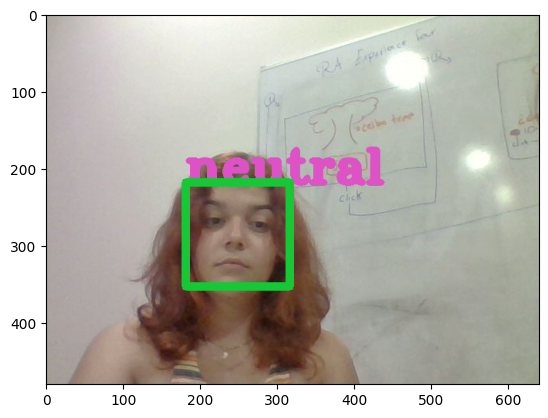

In [86]:
from tensorflow.python.ops.math_ops import sign
# start streaming video from webcam
video_stream()
# label for video
label_html = 'Capturing...'
# initialze bounding box to empty
bbox = ''
count = 0 
listn = []
while True:
  js_reply = video_frame(label_html, bbox)
  if not js_reply:
    break

  # convert JS response to OpenCV Image
  img = js_to_image(js_reply["img"])
  img_copy = img

  # create transparent overlay for bounding box
  bbox_array = np.zeros([480,640,4], dtype=np.uint8)
  with open("/content/drive/MyDrive/Binary_archive/Archivo_j", "rb") as entre:
   j = pickle.load(entre)

  if count == j: #El tiempo para capturar el frame y procesarlo
    #Este sería el path de la imagen guardada
    image_path ='/content/drive/MyDrive/Frames/' + 'nombre' + str(j) +  '.jpg'
    #se guarda el fotograma con el "nombre" más el número del contador i
    cv2.imwrite(image_path , img) 
    listn.append(image_path)
    
    #Detectar los rostros usando Face Haar Cascade
    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #En faces_deteted se encuentran los rotros detectados
    faces_detected = face_haar_cascade.detectMultiScale(gray_image,1.32,5)
    #Imprimir ubicación de los rostros en la imagen
    print("Ubicación del rostro:", faces_detected)
    im2Display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    imTemp = im2Display.copy()
    listn.append([faces_detected])

    #Hacer un rectángulo en cada rostro detectado en la imagen
    for (x,y,w,h) in faces_detected:
        cv2.rectangle(img,(x,y), (x+w,y+h), (255,0,0), thickness=7)

        roi_gray=gray_image[y:y+w,x:x+h]
        roi_gray=cv2.resize(roi_gray,(48,48))

        #Processes the image and adjust it to pass it to the model
        image_pixels = tf.keras.preprocessing.image.img_to_array(roi_gray)
       
        image_pixels = np.expand_dims(image_pixels, axis = 0)
        image_pixels /= 255

        #Obtener las emociones para cada rostro detectado en la imagen
        #Get the prediction of the model
        predictions = model.predict(image_pixels)
        #Mostrar todas las emociones detectadas
        print("Predicciones: ", predictions)
        #Mostrar la emoción más significativa (con el valor más alto)
        max_index = np.argmax(predictions[0])
        print(max_index, predictions[0])
        #El orden en que vienen las emociones
        emotion_detection = ('angry', 'disgust', 'fear', 'happyness', 'sadness', 'surprise', 'neutral')

        emotion_prediction = emotion_detection[max_index]
        #Crear un diccionario para almacenar la emoción y el valor para la emoción
        frame_dic = dict(
            angry = predictions[0][0],
            disgust = predictions[0][1],
            fear = predictions[0][2],            
            happiness = predictions[0][3],
            sadness = predictions[0][4],
            surprise = predictions[0][5],
            neutral = predictions[0][6]) 
        print("Predicciones: ", frame_dic)
        listn.append(frame_dic)
        print( emotion_prediction )
        
        #Mostrar en la imagen un texto de la emoción más significativa
        ubicacion = (x,y)
        font = cv2.FONT_HERSHEY_TRIPLEX
        tamañoLetra = 2
        colorLetra = (221,82,196)
        grosorLetra = 7
        #Escribir texto con la emoción más significativa
        cv2.putText(imTemp, emotion_prediction, ubicacion, font, tamañoLetra, colorLetra, grosorLetra)
        pt1 = (x, y)
        pt2 = (x+w, y+h)
        color = (23,200,54)
        thickness = 10
        cv2.rectangle(imTemp, pt1, pt2, color, thickness)

    #Mostrar la imagen con los cuadros en los rostros y el texto de la emoción más significativa
    plt.imshow(imTemp)
    plt.show()

    j +=5
    with open("/content/drive/MyDrive/Binary_archive/Archivo_j", "wb") as entre:
      pickle.dump(j, entre)
  count +=1

In [ ]:
import pickle
def evaluator():
  """This function creates an evaluator instance with all the information and
  saves it in a pickle archive called Archivo_evaluador. 
  """
  #Code to ask all the individual's information
  ID = int(input("Place your identification: "))
  name = input("Place your name: ", )
  birth_date = input("Place your birth date(year/month/day): ")
  age = int(input("Place your age: "))
  nationality = input("Place your nationality: ")
  telephone = {}
  telephone["telephone_number"] = []
  k = 0
  print("How many telephone numbers do you want to add?")
  amount = int(input("Place the amount: "))
  while k < amount:
     phone = int(input("Place your number: "))
     telephone["telephone_number"].append(phone)
     k = k + 1
  gender = input("Place your gender(female or male): ")
  k = 0
  email = []
  print("How many emails do you want to add?")
  amount = int(input("Place the amount: "))
  while k < amount:
     emai = input("Place your email: ")
     email.append(emai)
     k = k + 1
  address = input("Place your address: ")
  specialty = input("Place your specialty: ") 
  technical_programs = input("Place one technical program: ")
  languages = int(input("Place the amount of languages you speak: "))
  

  #Creation of the instance
  Individual = Evaluator(ID, name, birth_date, age, nationality, telephone, gender, email, address, specialty, technical_programs, languages)

  #Code to save the instance in a pickle archive and replace the instances of people already interviewed.
  with open("/content/drive/MyDrive/Binary_archive/Archivo_Evaluador", "rb") as entre:
    Archive_evaluator = pickle.load(entre)
  for x in Archive_evaluator:
    if x.identification == Individual.identification:
       Archive_evaluator.remove(x)
  Archive_evaluator.append(Individual)
  with open("/content/drive/MyDrive/Binary_archive/Archivo_Evaluador", "wb") as entre:
      pickle.dump(Archive_evaluator, entre)





def interviewer():
  """This function creates an interviewer instance with all the information and
  saves it in a pickle archive called Archivo_entrevistador. 
  """
  #Code to ask all the individual's information
  ID = int(input("Place your identification: "))
  name = input("Place your name: ", )
  birth_date = input("Place your birth date(year/month/day): ")
  age = int(input("Place your age: "))
  nationality = input("Place your nationality: ")
  telephone = {}
  telephone["telephone_number"] = []
  k = 0
  print("How many telephone numbers do you want to add?")
  amount = int(input("Place the amount: "))
  while k < amount:
     phone = int(input("Place your number: "))
     telephone["telephone_number"].append(phone)
     k = k + 1
  gender = input("Place your gender(female or male): ")
  k = 0
  email = []
  print("How many emails do you want to add?")
  amount = int(input("Place the amount: "))
  while k < amount:
     emai = input("Place your email: ")
     email.append(emai)
     k = k + 1
  address = input("Place your address: ")
  code_number = int(input("Place your code_number: "))
  certificate = int(input("Place your certificate code: "))
  experience = int(input("Place your experience years: "))

  #Creation of the instance
  Individual = Interviewer(ID, name, birth_date, age, nationality, telephone, gender, email, address, code_number, certificate, experience)

  #Code to save the instance in a pickle archive and replace the instances of people already interviewed.
  with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistador", "rb") as entre:
    Archive_interviewer = pickle.load(entre)
  for x in Archive_interviewer:
    if x.identification == Individual.identification:
       Archive_interviewer.remove(x)
  Archive_interviewer.append(Individual)
  with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistador", "wb") as entre:
      pickle.dump(Archive_interviewer, entre)




def interviewee():
  """This function creates an interviewee instance with all the information and
  saves it in a pickle archive called Archivo_entrevistado. 
  """

  #Code to ask all the individual's information
  ID = int(input("Place your identification: "))
  name = input("Place your name: ", )
  birth_date = input("Place your birth date(year/month/day): ")
  age = int(input("Place your age: "))
  telephone = {}
  telephone["telephone_number"] = []
  k = 0
  print("How many telephone numbers do you want to add?")
  amount = int(input("Place the amount: "))
  while k < amount:
     phone = int(input("Place your number: "))
     telephone["telephone_number"].append(phone)
     k = k + 1
     if k == 3:
      break
  gender = input("Place your gender(female or male): ")
  k = 0
  email = []
  print("How many emails do you want to add?")
  amount = int(input("Place the amount: "))
  while k < amount:
     emai = input("Place your email: ")
     email.append(emai)
     k = k + 1
     if k == 3:
      break
  address = input("Place your address: ")
  marital_status = input("Place your marital status: ")
  nationality = input("Place your nationality: ")
  number = int(input("Place how many children you have: "))
  state = "Interviewed"
  c = 0
  children = {}
  children["number"] = number 
  children["info"] = []

  # Code to classify the children information in case there is more than one.
  while c < number:
   u = input("Place your child's gender(female or male): ")
   a = input("Place your child's birth date: ")
   ll = []
   ll.append(u) 
   ll.append(a)
   children["info"].append(ll)
   c = c + 1
  job = input("Place what is your job: ") 
  salary = int(input("Place what is your salary: "))
  academic_grade = input("Place your academic grade: ")
  
  
  
  

  # Code to classify the information of the images in sub lists of 3 values inside a list.
  ll = []
  c = 0
  p = 3
  pp = []
  a = len(listn)
  while c < a:
   for x in listn:
    pp.append(x)
    p = p - 1
    a = a - 1
    if p == 0:
      ll.append(pp)
      pp = []
      p = 3 

  #Creation of the instance
  Individual = Interviewee(ID, name, birth_date, age, nationality, telephone, gender, email, address, marital_status, children, job, salary, academic_grade, state, ll)

  #Code to save the instance in a pickle archive and replace the instances of people already interviewed.
  with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistado", "rb") as entre:
     Archive_interviewee = pickle.load(entre)
  for x in Archive_interviewee:
    if x.identification == Individual.identification:
       Archive_interviewee.remove(x)
  Archive_interviewee.append(Individual)
  with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistado", "wb") as entre:
      pickle.dump(Archive_interviewee, entre) 


In [87]:
#Menu to create new instances
while True:
 print("What is your profile?: ")
 print("\nEvaluator 1","\nInterviewer 2","\nInterviewee 3","\nFinish 0" )
 print("Place your profile number")

 v = int(input())
 if v == 1:
   evaluator()
 elif v == 2:
   interviewer()
 elif v == 3:
   interviewee()
 elif v == 0:
  break
 else:
  print("Error, place a number given by the menu")
   


What is your profile?: 

Evaluator 1 
Interviewer 2 
Interviewee 3 
Finish 0
Place your profile number
3
Place your identification: 208580753
Place your name: Nayarín Zilena Solano Vasquez
Place your birth date(year/month/day): 2004/10/05
Place your age: 18
How many telephone numbers do you want to add?
Place the amount: 1
Place your number: 85227510
Place your gender(female or male): female
How many emails do you want to add?
Place the amount: 1
Place your email: nz.solano05@gmail.com
Place your address: 100 mts del Aserradero, Alajuela
Place your marital status: Single
Place your nationality: Costa Rican
Place how many children you have: 0
Place what is your job: Student
Place what is your salary: 100000
Place your academic grade: University uncompleted
What is your profile?: 

Evaluator 1 
Interviewer 2 
Interviewee 3 
Finish 0
Place your profile number
0


In [89]:
#Library pickle to save archives.
import pickle
with open("/content/drive/MyDrive/Binary_archive/Archivo_Evaluador", "rb") as entre:
    Archive_evaluator = pickle.load(entre)
for x in Archive_evaluator:
  print(x)
print("---------")
with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistador", "rb") as entre:
  Archive_interviewer = pickle.load(entre)
for x in Archive_interviewer:
    print(x)
with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistado", "rb") as entre:
  Archive_interviewee = pickle.load(entre)
print("---------")
for x in Archive_interviewee:
  print(x)

name: José Joaquín Blanco Rodríguez, identitification: 203640993, birth_date: 1961/10/29, age: 61, nationality: Costa Rican, telephone_numbers: {'telephone_number': [87803279]}, gender: male, emails: ['joseblanco@gmail.com'], address: Zarcero, specialty: Accounting, technical_programs: Avix, languages: 1
---------
name: Lorena Piedra Madrigal, identitification: 204030421, birth_date: 1965/02/20, age: 58, nationality: Costa Rican, telephone_numbers: {'telephone_number': [86569494, 86454320]}, gender: female, emails: ['Lorenapiedra@gmail.com'], address: Zarcero, code_number: 267876, certificate: 35262, experience: 10
---------
name: Sharon Blanco Piedra, identitification: 208500806, birth_date: 2004/02/07, age: 19, nationality: Costa Rican, telephone_numbers: {'telephone_number': [84166154]}, gender: female, emails: ['sharoniris889@gmail.com'], address: Zarcero, marithal_status: Single, children: {'number': 2, 'info': [['female', '2010/02/09'], ['female', '2005/09/08']]}, job: Student, s

#Inquiry 1

Show all the information of all the interviews out of the objects, lists and dictionaries, besides the emotions, coordenates and images.


Sharon Blanco Piedra
208500806
2004/02/07
19
Costa Rican
84166154
female
sharoniris889@gmail.com
Zarcero
Single
children: 
number 2
info
female
2010/02/09
female
2005/09/08
Student
0
University uncompleted
Interviewed


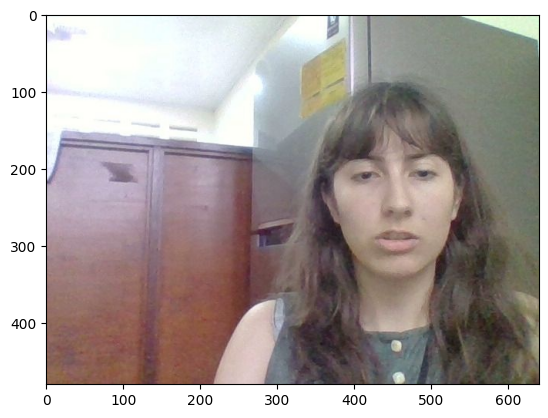

Coordinates: 360 133 190 190 
angry : 0.05418329
disgust : 0.0003852114
fear : 0.13798892
happiness : 0.004647939
sadness : 0.34774035
surprise : 0.0037103035
neutral : 0.45134392


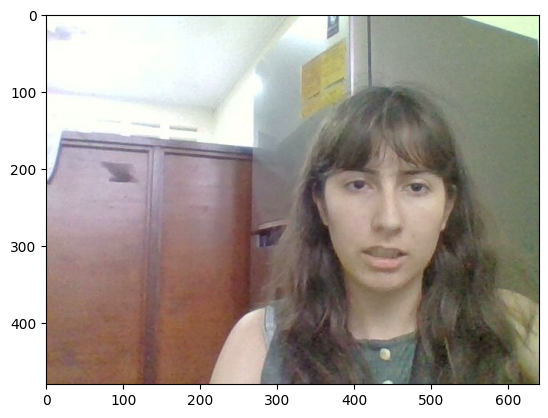

Coordinates: 347 148 194 194 
angry : 0.03821704
disgust : 0.00025661592
fear : 0.08827759
happiness : 0.011761979
sadness : 0.19142021
surprise : 0.0073959325
neutral : 0.6626707


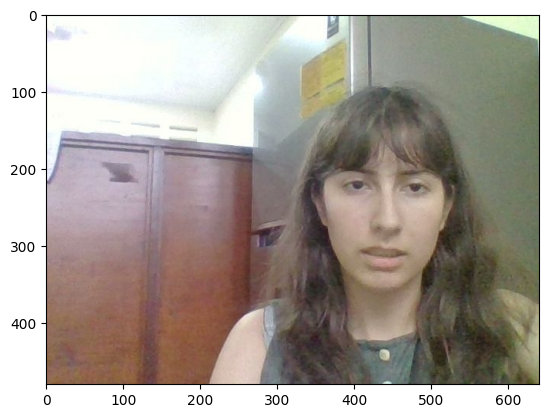

Coordinates: 344 146 197 197 
angry : 0.027986819
disgust : 0.00010510175
fear : 0.05635618
happiness : 0.0072276243
sadness : 0.14875978
surprise : 0.00345685
neutral : 0.7561076


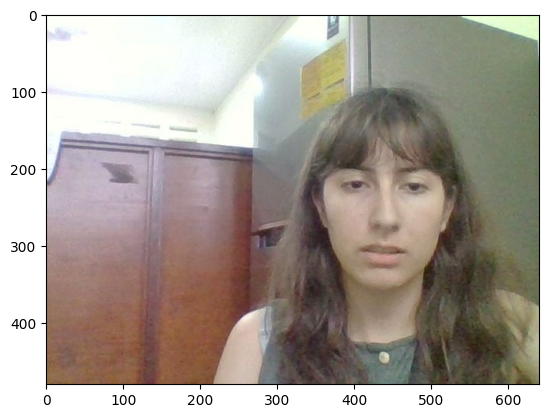

Coordinates: 333 135 212 212 
angry : 0.038025957
disgust : 0.00018448247
fear : 0.099094234
happiness : 0.006433476
sadness : 0.3251961
surprise : 0.0018118734
neutral : 0.52925384


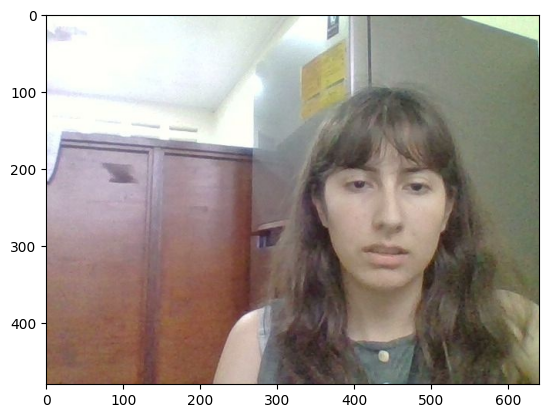

Coordinates: 346 147 198 198 
angry : 0.03838399
disgust : 0.00026997263
fear : 0.08535903
happiness : 0.013804071
sadness : 0.18479683
surprise : 0.0077278307
neutral : 0.66965824


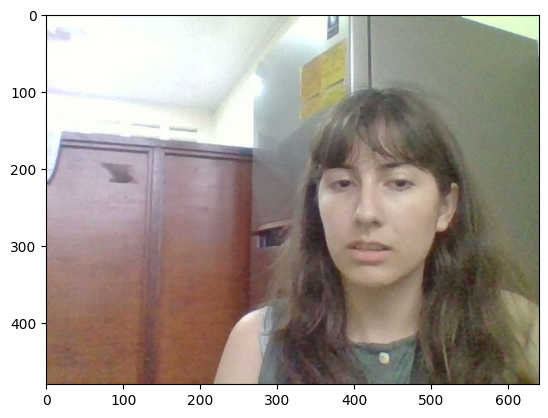

Coordinates: 324 148 190 190 
angry : 0.040059008
disgust : 0.0004804586
fear : 0.18279456
happiness : 0.0059131244
sadness : 0.5617843
surprise : 0.0023823802
neutral : 0.20658617


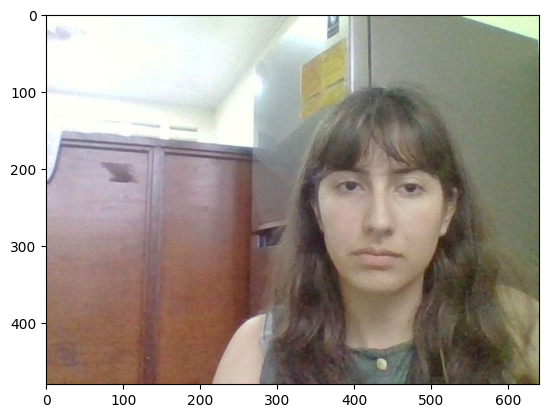

Coordinates: 334 150 196 196 
angry : 0.042872876
disgust : 0.00017620734
fear : 0.09885883
happiness : 0.0032340328
sadness : 0.329755
surprise : 0.0014826109
neutral : 0.5236204


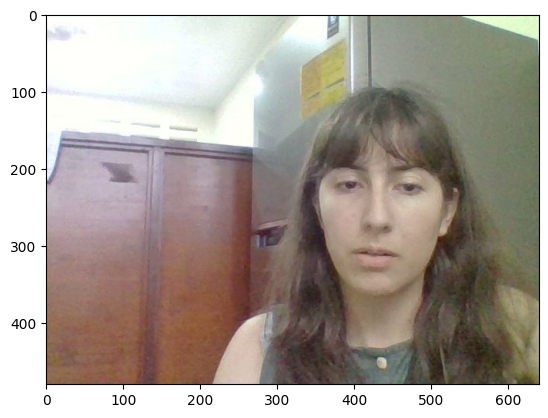

Coordinates: 329 147 202 202 
angry : 0.05817868
disgust : 0.0006632163
fear : 0.1622454
happiness : 0.011053605
sadness : 0.3946951
surprise : 0.0052030385
neutral : 0.367961

Nayarín Zilena Solano Vasquez
208580753
2004/10/05
18
Costa Rican
85227510
female
nz.solano05@gmail.com
100 mts del Aserradero, Alajuela
Single
children: 
number 0
info
Student
100000
University uncompleted
Interviewed


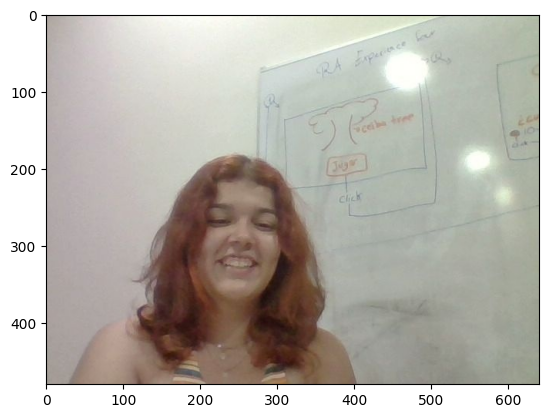

Coordinates: 193 220 128 128 
angry : 0.00043732207
disgust : 7.0315396e-06
fear : 0.0006251849
happiness : 0.9884908
sadness : 0.0015406163
surprise : 0.00030959008
neutral : 0.008589462


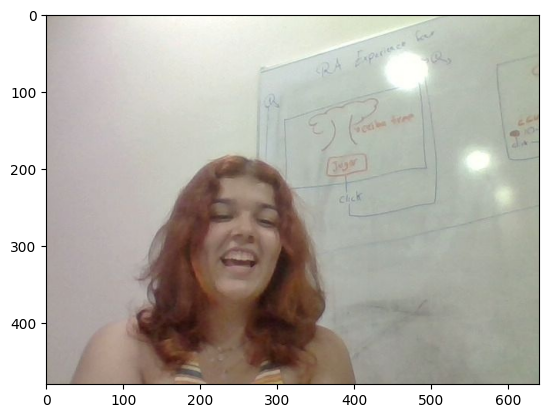

Coordinates: 197 215 125 125 
angry : 0.026210755
disgust : 0.0029591594
fear : 0.059502408
happiness : 0.7597421
sadness : 0.116197914
surprise : 0.0056549767
neutral : 0.029732708


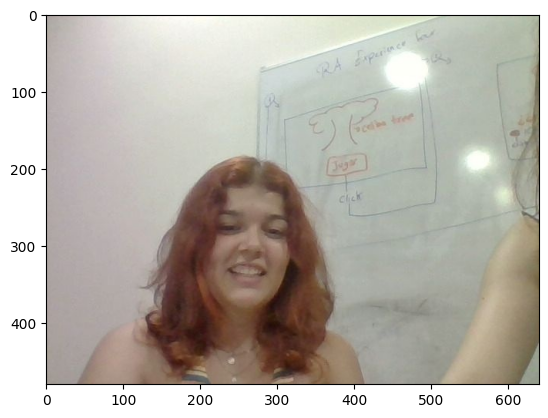

Coordinates: 201 227 135 135 
angry : 0.0011692893
disgust : 1.8147877e-05
fear : 0.0014320682
happiness : 0.9772365
sadness : 0.0025816308
surprise : 0.00090177485
neutral : 0.016660523


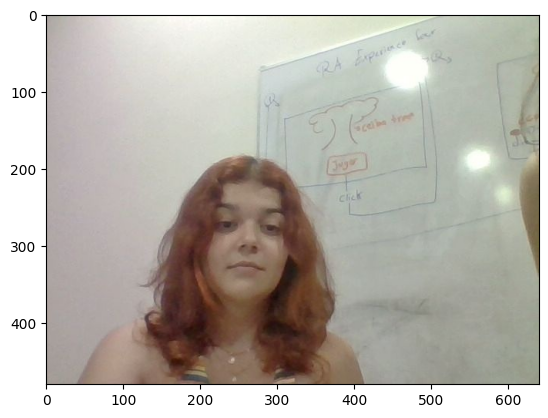

Coordinates: 194 223 138 138 
angry : 0.031156572
disgust : 0.0005421657
fear : 0.02391088
happiness : 0.25622874
sadness : 0.08125325
surprise : 0.0046429653
neutral : 0.6022654


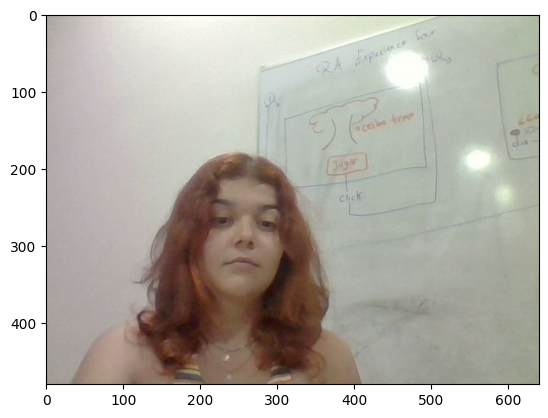

Coordinates: 188 214 141 141 
angry : 0.04716747
disgust : 0.00055534724
fear : 0.03717024
happiness : 0.10898482
sadness : 0.13996193
surprise : 0.003121622
neutral : 0.66303855


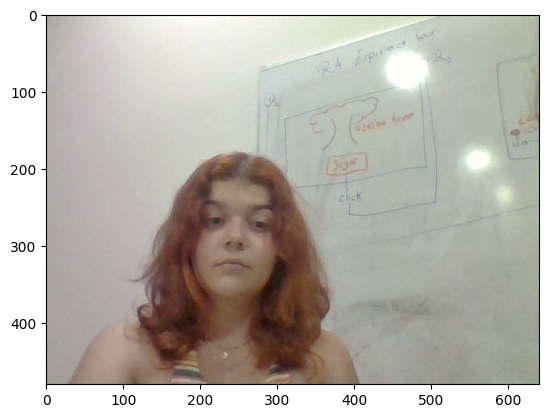

Coordinates: 181 218 135 135 
angry : 0.07094956
disgust : 0.0006197189
fear : 0.095689036
happiness : 0.010084095
sadness : 0.3783751
surprise : 0.0015023345
neutral : 0.4427802


In [90]:
def show_info(Archive):
  """ This function shows all the information of instances inside a list.
  Arguments:
        Archive {list} -- List with people's instances.
  """

  # Code to export all the information.
  for x in Archive:
    print()
    print(x.name)
    print(x.identification)
    print(x.birth_date)
    print(x.age)
    print(x.nationality)
    for e, y in x.telephone_numbers.items():
      for i in y:
        print(i)
    print(x.gender)
    for i in x.emails:
      print(i)
    print(x.address)
    print(x.marital_status)
    print("children: ")
    for j, p in x.children.items():
      if j == "info":
        print(j)
        for k in p:
          for y in k:
            print(y)
      else:
        print(j, p)
    print(x.job)
    print(x.salary)
    print(x.academic_grade)
    print(x.state)
    for x in x.images:
        show_image(x[0])
        p = x[1][0][0]
        print("Coordinates: ", end= '')
        for e in p:
          print(e, end=' ')
        print()
        for w, y  in x[2].items():
          print(w, ":", y)

show_info(Archive_interviewee)

#Inquiry 2

Show all the people information sorted out upwardly based on their aged and using the insertion method.

In [91]:
#Library to know the current date.
from datetime import datetime
def knowagei(birthdate):
 """The function gets the age of a person based on their birth date.
    Arguments:
        birthdate {str} -- Birth date.
    Returns:
        age {int} -- Age.
 """
 now = datetime.now()
 actualyear = now.year
 actualmonth = now.month
 date_string = birthdate
 date = datetime.strptime(date_string, "%Y/%m/%d")
 day = date.day
 month = date.month
 year = date.year
 age = actualyear - year
 mont = month - actualmonth
 if mont > 0:
   age = age - 1
 return age


Nayarín Zilena Solano Vásquez
208580753
2004/10/05
18
Costa Rican
85227510
female
nz.solano05@gmail.com
100 este del super Los Años, Alajuela
Single
children: 
number 0
info
Student
100000
University uncompleted
Interviewed


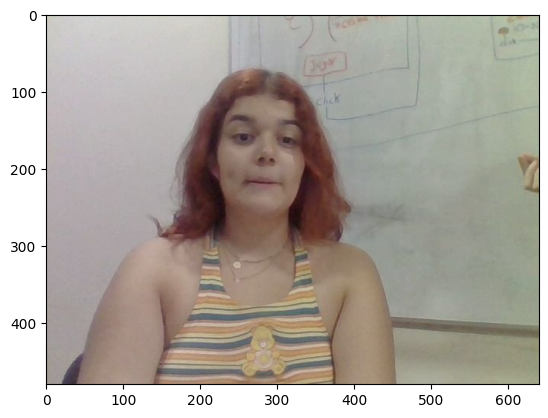

Coordinates: 209 102 150 150 
angry : 0.020361172
disgust : 0.00048239352
fear : 0.016320417
happiness : 0.44126818
sadness : 0.05623971
surprise : 0.004756021
neutral : 0.46057212


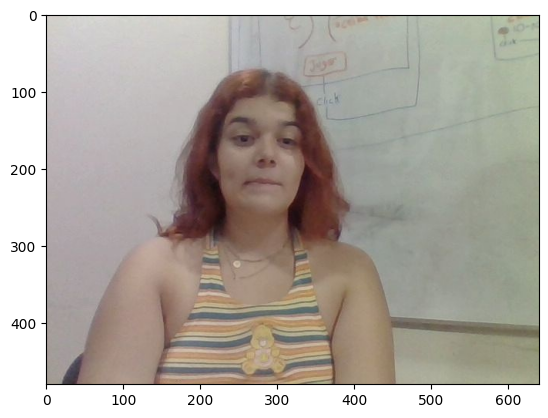

Coordinates: 209 103 148 148 
angry : 0.034983966
disgust : 0.0005281291
fear : 0.029535988
happiness : 0.16659912
sadness : 0.07314596
surprise : 0.009379001
neutral : 0.68582785


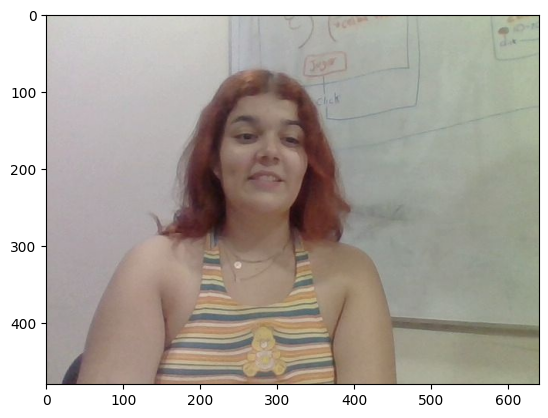

Coordinates: 220 107 136 136 
angry : 0.0076787667
disgust : 0.0003303962
fear : 0.008336074
happiness : 0.85389847
sadness : 0.034052793
surprise : 0.0023724036
neutral : 0.09333111


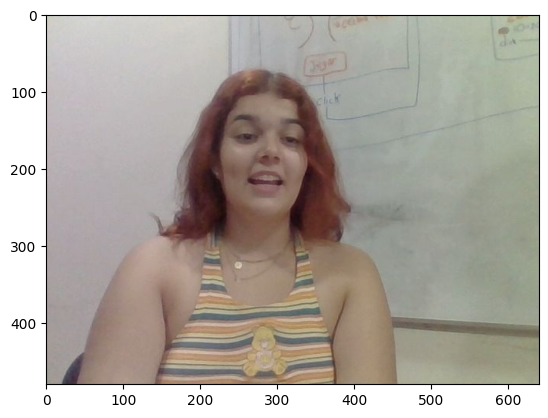

Coordinates: 215 103 146 146 
angry : 0.0010526612
disgust : 1.6402226e-05
fear : 0.0033374985
happiness : 0.95517135
sadness : 0.004034826
surprise : 0.003632249
neutral : 0.032754984


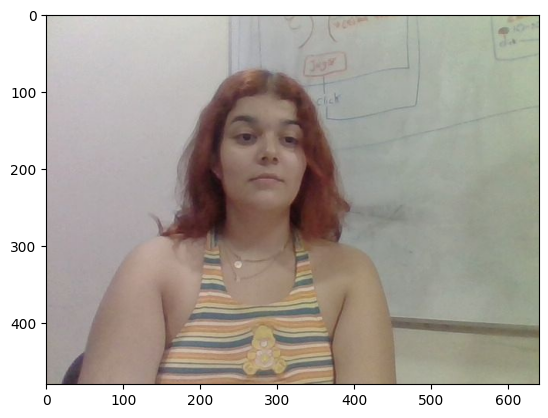

Coordinates: 219 106 139 139 
angry : 0.040402975
disgust : 0.00029874503
fear : 0.05515614
happiness : 0.031981796
sadness : 0.1719028
surprise : 0.0034753107
neutral : 0.6967822


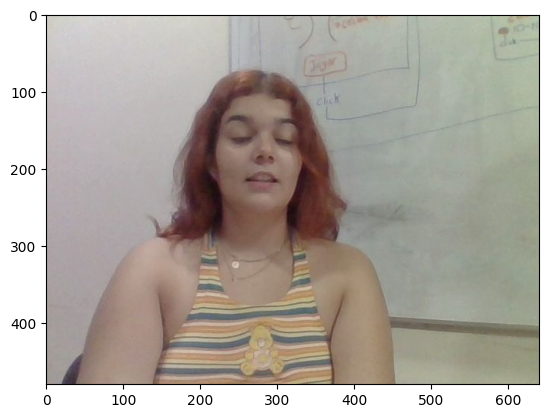

Coordinates: 206 102 150 150 
angry : 0.070075266
disgust : 0.0013777346
fear : 0.16211437
happiness : 0.025205147
sadness : 0.4121669
surprise : 0.0070042713
neutral : 0.32205632


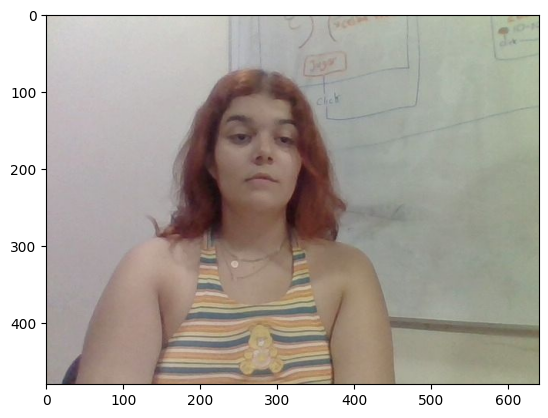

Coordinates: 212 108 138 138 
angry : 0.038467646
disgust : 0.00018162954
fear : 0.08594228
happiness : 0.0053528957
sadness : 0.29568925
surprise : 0.0016081475
neutral : 0.5727581


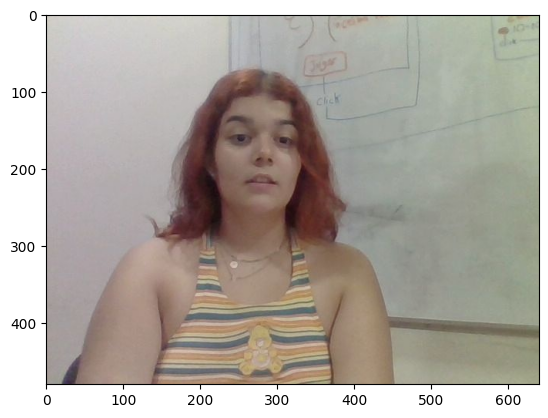

Coordinates: 205 100 152 152 
angry : 0.03556578
disgust : 0.00020933973
fear : 0.08571302
happiness : 0.010031743
sadness : 0.2372639
surprise : 0.0033669784
neutral : 0.6278492


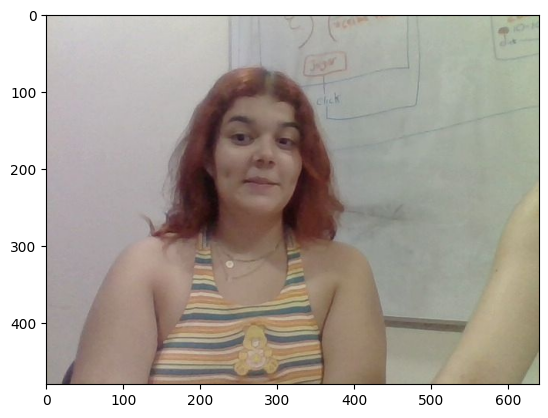

Coordinates: 213 108 139 139 
angry : 0.009524288
disgust : 0.00024110744
fear : 0.007739179
happiness : 0.6624094
sadness : 0.028979447
surprise : 0.0035047838
neutral : 0.2876018


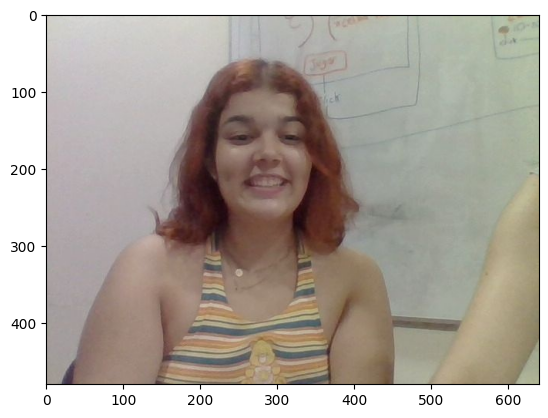

Coordinates: 208 95 155 155 
angry : 0.0007047875
disgust : 9.740502e-06
fear : 0.0017788451
happiness : 0.9620969
sadness : 0.0028420023
surprise : 0.0019990464
neutral : 0.030568589

Sharon Blanco Piedra
208500806
2004/02/07
19
Costa Rican
84166154
female
sharoniris889@gmail.com
Zarcero
Single
children: 
number 2
info
female
2010/02/09
female
2005/09/08
Student
0
University umcompleted
Interviewed


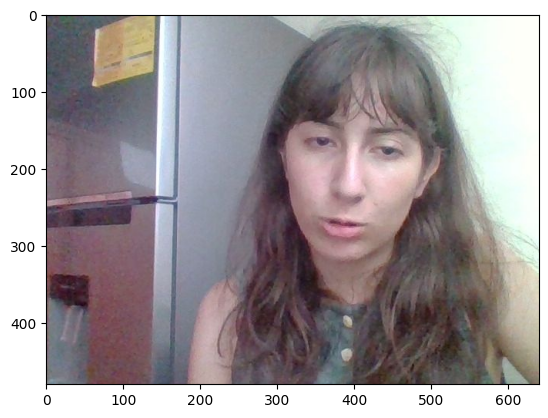

Coordinates: 293 96 202 202 
angry : 0.028500315
disgust : 0.00020446234
fear : 0.17040405
happiness : 0.0022398678
sadness : 0.61196434
surprise : 0.0010723318
neutral : 0.1856146


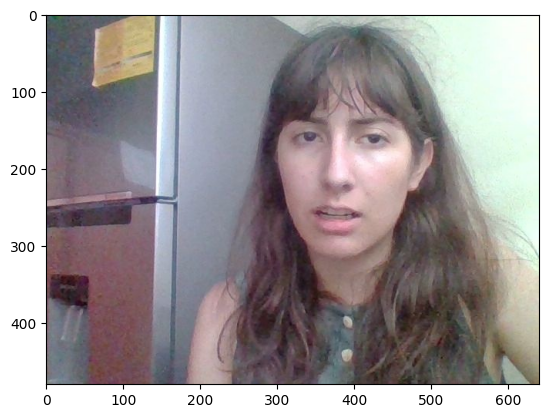

Coordinates: 270 75 224 224 
angry : 0.061556228
disgust : 0.0007827521
fear : 0.27372935
happiness : 0.0032083958
sadness : 0.44901925
surprise : 0.006674626
neutral : 0.2050294


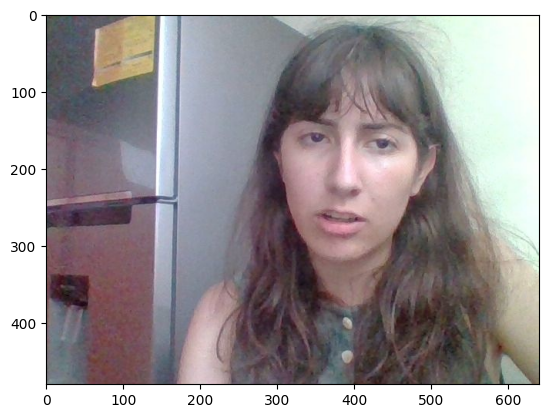

Coordinates: 273 73 236 236 
angry : 0.055036526
disgust : 0.00039639242
fear : 0.1081484
happiness : 0.0086319335
sadness : 0.25365385
surprise : 0.005756239
neutral : 0.5683767


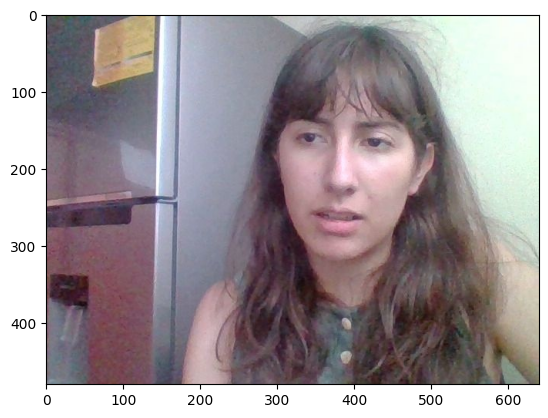

Coordinates: 273 73 227 227 
angry : 0.04791984
disgust : 0.0004353562
fear : 0.17130281
happiness : 0.006390978
sadness : 0.3881648
surprise : 0.004973029
neutral : 0.38081324


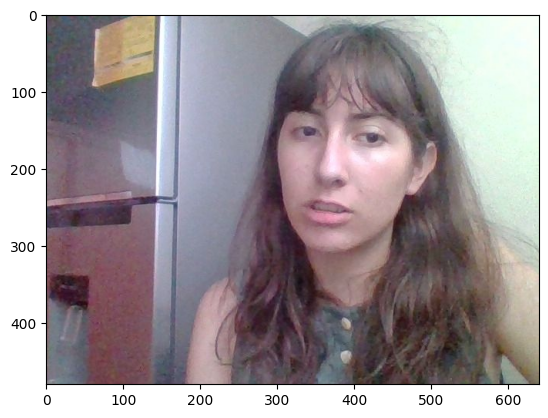

Coordinates: 268 75 215 215 
angry : 0.05588369
disgust : 0.0005079738
fear : 0.16561593
happiness : 0.003822126
sadness : 0.49955148
surprise : 0.0020790272
neutral : 0.2725398


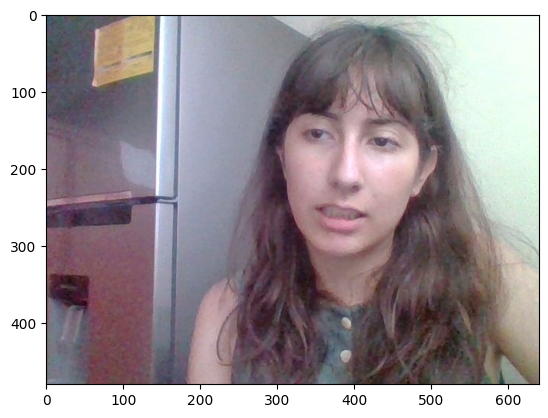

Coordinates: 283 78 217 217 
angry : 0.0766823
disgust : 0.0010202747
fear : 0.15004158
happiness : 0.012991944
sadness : 0.31771123
surprise : 0.008408064
neutral : 0.43314457


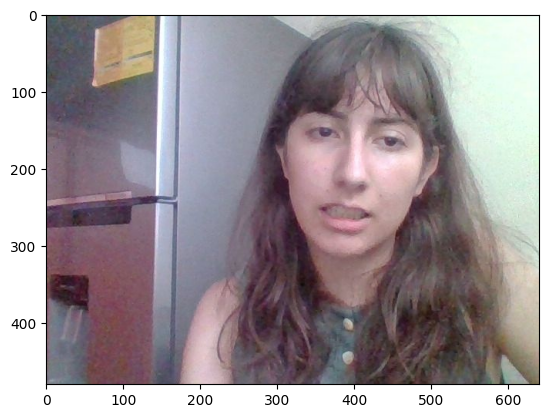

Coordinates: 283 66 236 236 
angry : 0.047728375
disgust : 0.00061486836
fear : 0.156518
happiness : 0.021237321
sadness : 0.377754
surprise : 0.006990463
neutral : 0.38915694


In [60]:
def insertion(Archive_interviewee):
  """The function gets a list and sorts it out by the insertion method.
    Arguments:
        Archive_interviewee {list} -- Unsorted list.
    Returns:
        newlis {list} -- Sorted list.
  """
  newlis = []
  li = list(Archive_interviewee)
  while len(li) != 0:
    m = 200
    for x in li:
      if knowagei(x.birth_date) < m:
        m = knowagei(x.birth_date)
        t = x
    newlis.append(t)
    li.remove(t)
    #print(li)
  show_info(newlis)
insertion(Archive_interviewee)


#Inquiry 3

Show all the people information sorted out in descending based on the amount of children they have using the bubble method.


Sharon Blanco Piedra
208500806
2004/02/07
19
Costa Rican
84166154
female
sharoniris889@gmail.com
Zarcero
Single
children: 
number 2
info
female
2010/02/09
female
2005/09/08
Student
0
University uncompleted
Interviewed


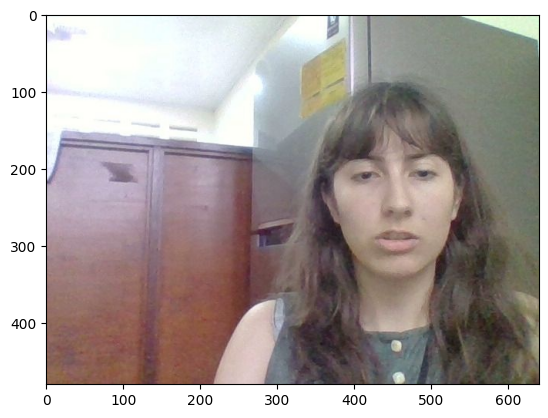

Coordinates: 360 133 190 190 
angry : 0.05418329
disgust : 0.0003852114
fear : 0.13798892
happiness : 0.004647939
sadness : 0.34774035
surprise : 0.0037103035
neutral : 0.45134392


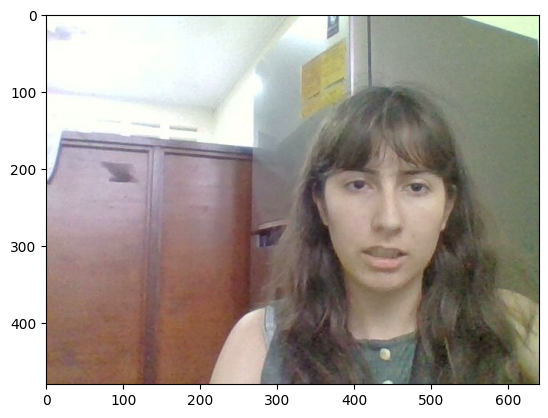

Coordinates: 347 148 194 194 
angry : 0.03821704
disgust : 0.00025661592
fear : 0.08827759
happiness : 0.011761979
sadness : 0.19142021
surprise : 0.0073959325
neutral : 0.6626707


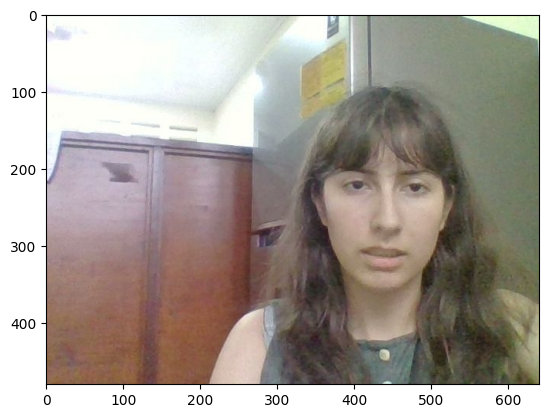

Coordinates: 344 146 197 197 
angry : 0.027986819
disgust : 0.00010510175
fear : 0.05635618
happiness : 0.0072276243
sadness : 0.14875978
surprise : 0.00345685
neutral : 0.7561076


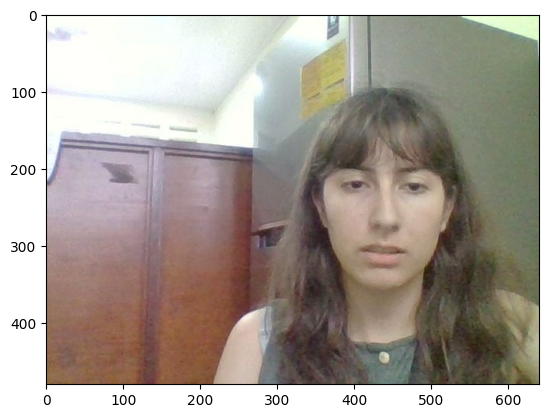

Coordinates: 333 135 212 212 
angry : 0.038025957
disgust : 0.00018448247
fear : 0.099094234
happiness : 0.006433476
sadness : 0.3251961
surprise : 0.0018118734
neutral : 0.52925384


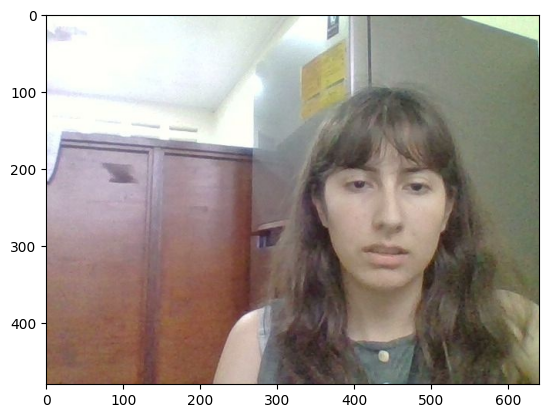

Coordinates: 346 147 198 198 
angry : 0.03838399
disgust : 0.00026997263
fear : 0.08535903
happiness : 0.013804071
sadness : 0.18479683
surprise : 0.0077278307
neutral : 0.66965824


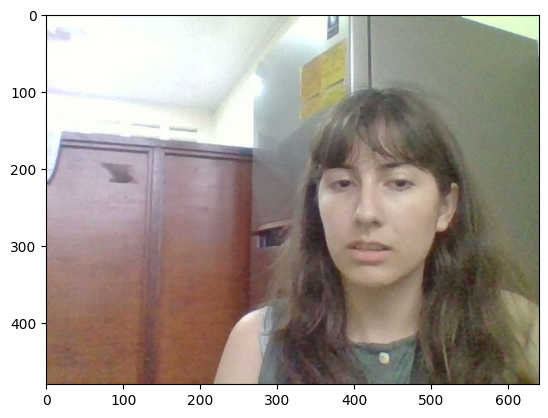

Coordinates: 324 148 190 190 
angry : 0.040059008
disgust : 0.0004804586
fear : 0.18279456
happiness : 0.0059131244
sadness : 0.5617843
surprise : 0.0023823802
neutral : 0.20658617


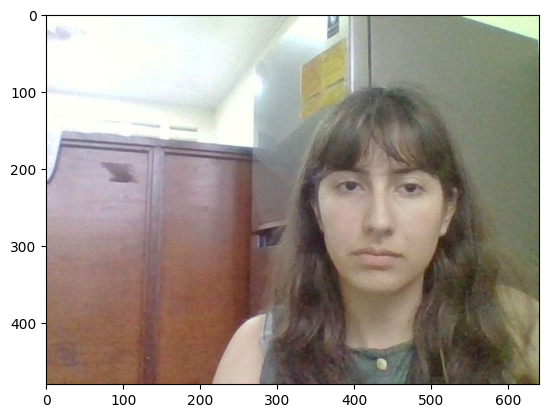

Coordinates: 334 150 196 196 
angry : 0.042872876
disgust : 0.00017620734
fear : 0.09885883
happiness : 0.0032340328
sadness : 0.329755
surprise : 0.0014826109
neutral : 0.5236204


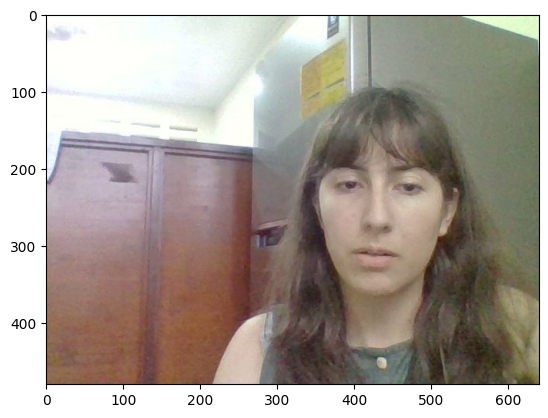

Coordinates: 329 147 202 202 
angry : 0.05817868
disgust : 0.0006632163
fear : 0.1622454
happiness : 0.011053605
sadness : 0.3946951
surprise : 0.0052030385
neutral : 0.367961

Nayarín Zilena Solano Vasquez
208580753
2004/10/05
18
Costa Rican
85227510
female
nz.solano05@gmail.com
100 mts del Aserradero, Alajuela
Single
children: 
number 0
info
Student
100000
University uncompleted
Interviewed


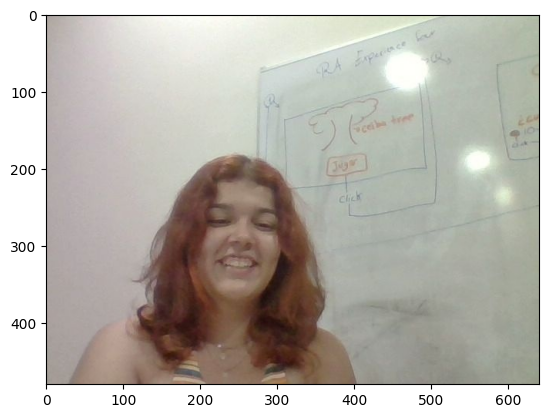

Coordinates: 193 220 128 128 
angry : 0.00043732207
disgust : 7.0315396e-06
fear : 0.0006251849
happiness : 0.9884908
sadness : 0.0015406163
surprise : 0.00030959008
neutral : 0.008589462


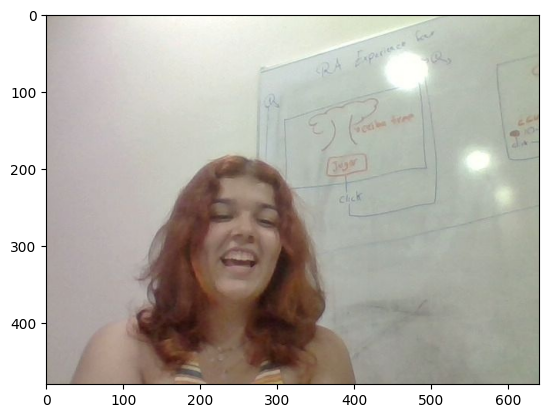

Coordinates: 197 215 125 125 
angry : 0.026210755
disgust : 0.0029591594
fear : 0.059502408
happiness : 0.7597421
sadness : 0.116197914
surprise : 0.0056549767
neutral : 0.029732708


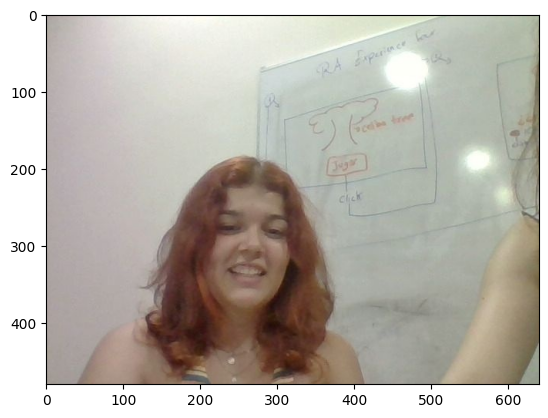

Coordinates: 201 227 135 135 
angry : 0.0011692893
disgust : 1.8147877e-05
fear : 0.0014320682
happiness : 0.9772365
sadness : 0.0025816308
surprise : 0.00090177485
neutral : 0.016660523


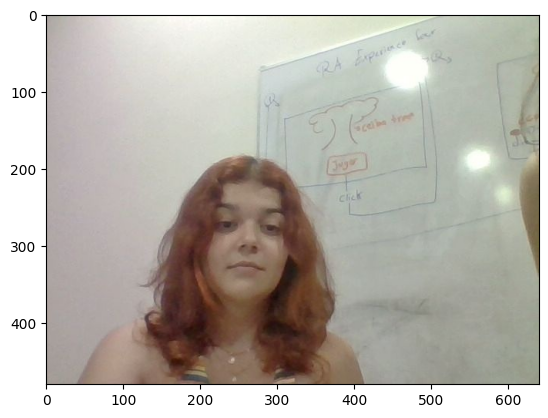

Coordinates: 194 223 138 138 
angry : 0.031156572
disgust : 0.0005421657
fear : 0.02391088
happiness : 0.25622874
sadness : 0.08125325
surprise : 0.0046429653
neutral : 0.6022654


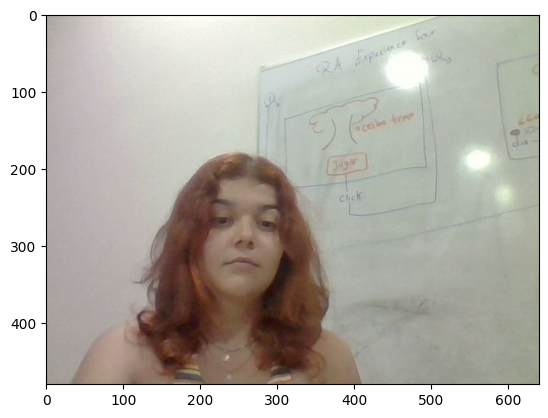

Coordinates: 188 214 141 141 
angry : 0.04716747
disgust : 0.00055534724
fear : 0.03717024
happiness : 0.10898482
sadness : 0.13996193
surprise : 0.003121622
neutral : 0.66303855


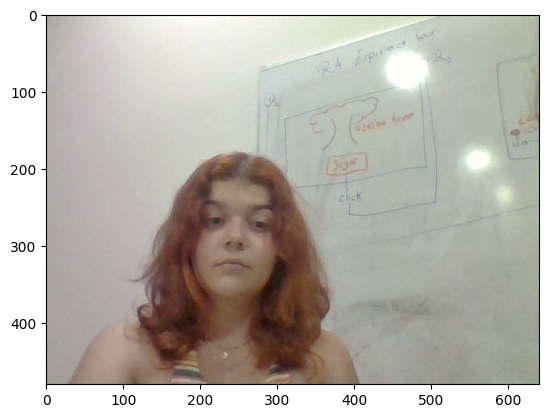

Coordinates: 181 218 135 135 
angry : 0.07094956
disgust : 0.0006197189
fear : 0.095689036
happiness : 0.010084095
sadness : 0.3783751
surprise : 0.0015023345
neutral : 0.4427802


In [92]:
def bubble(archive_interviewee):
    """This function takes a list and sorts it by the bubble method.
    Arguments:
         archive_interviewee {list} -- Unsorted list.
    Returns:
        list_ {list} -- Sorted list.
    """
    list_ = list(archive_interviewee)
    times = len(list_) - 1
    while times > 0:
        pos = 0
        while pos < times:
            if list_[pos].children["number"] < list_[pos+1].children["number"]:
                temp = list_[pos]
                list_[pos] = list_[pos+1]
                list_[pos+1] = temp
            pos = pos + 1
        times = times -1
    show_info(list_)
bubble(Archive_interviewee)

#Inquiry 4

Show all people information sorted out in descending based on the amount of children using the quicksort method. Besides, print a list with sublists where the first sublist has the information of all people with only female children, the second sublist with the people with only male children and the third sublist with people with both. 

In [93]:
def divide(listn):
    """Arguments:
        listn {list} -- Unsorted list.
    Returns:
        [bigger,pivot,smaller] {list} -- List with sublists with the smaller values, the pivot and the bigger values.
    """
    smaller = []
    bigger = []
    pivot = listn[-1]
    for x in listn[:-1]:
      if x.children["number"] < pivot.children["number"]:
            smaller.append(x)
      else:
            bigger.append(x) 
    return [bigger, pivot, smaller]


Sharon Blanco Piedra
208500806
2004/02/07
19
Costa Rican
84166154
female
sharoniris889@gmail.com
Zarcero
Single
children: 
number 2
info
female
2010/02/09
female
2005/09/08
Student
0
University uncompleted
Interviewed


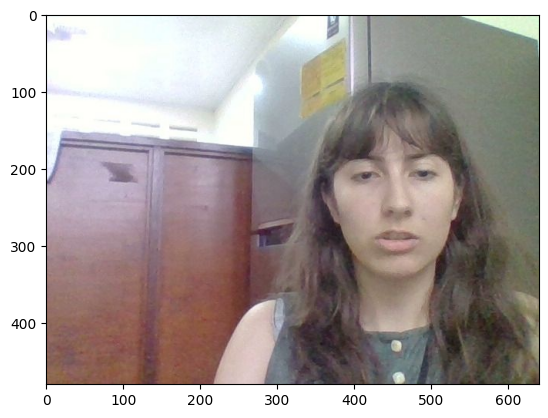

Coordinates: 360 133 190 190 
angry : 0.05418329
disgust : 0.0003852114
fear : 0.13798892
happiness : 0.004647939
sadness : 0.34774035
surprise : 0.0037103035
neutral : 0.45134392


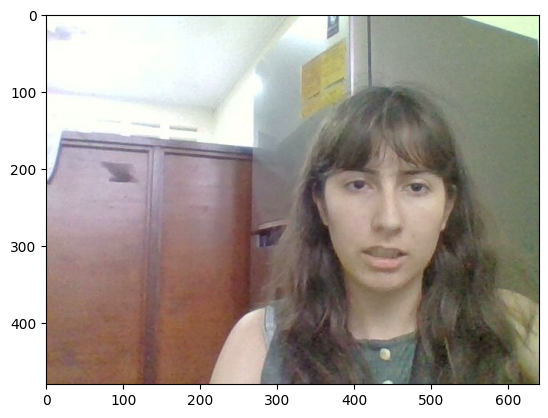

Coordinates: 347 148 194 194 
angry : 0.03821704
disgust : 0.00025661592
fear : 0.08827759
happiness : 0.011761979
sadness : 0.19142021
surprise : 0.0073959325
neutral : 0.6626707


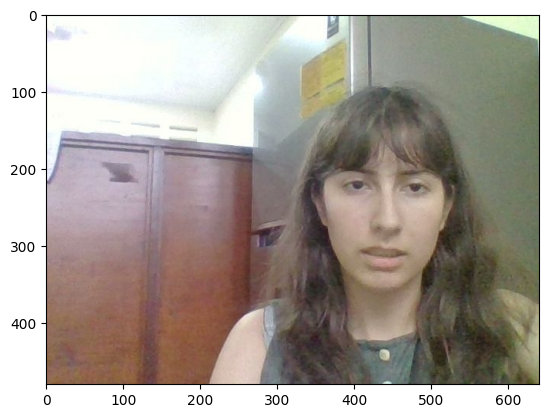

Coordinates: 344 146 197 197 
angry : 0.027986819
disgust : 0.00010510175
fear : 0.05635618
happiness : 0.0072276243
sadness : 0.14875978
surprise : 0.00345685
neutral : 0.7561076


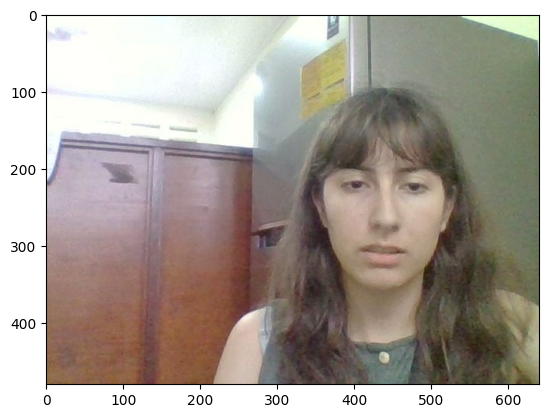

Coordinates: 333 135 212 212 
angry : 0.038025957
disgust : 0.00018448247
fear : 0.099094234
happiness : 0.006433476
sadness : 0.3251961
surprise : 0.0018118734
neutral : 0.52925384


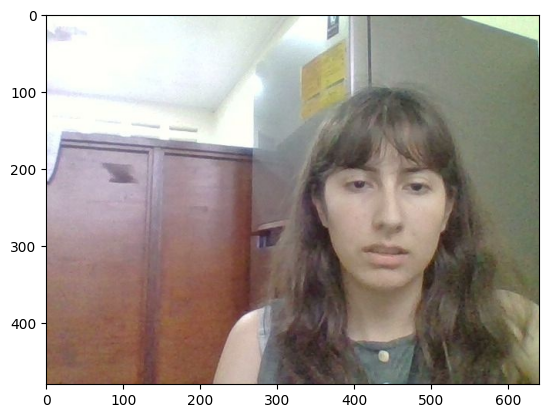

Coordinates: 346 147 198 198 
angry : 0.03838399
disgust : 0.00026997263
fear : 0.08535903
happiness : 0.013804071
sadness : 0.18479683
surprise : 0.0077278307
neutral : 0.66965824


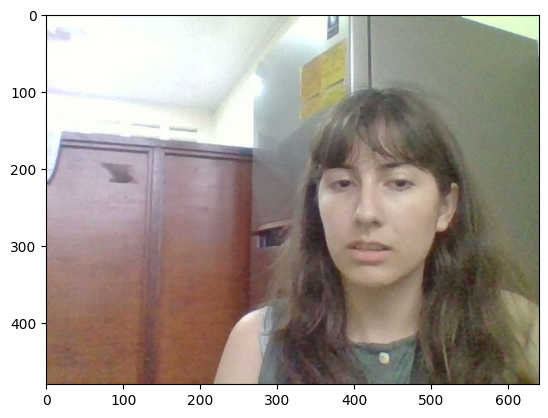

Coordinates: 324 148 190 190 
angry : 0.040059008
disgust : 0.0004804586
fear : 0.18279456
happiness : 0.0059131244
sadness : 0.5617843
surprise : 0.0023823802
neutral : 0.20658617


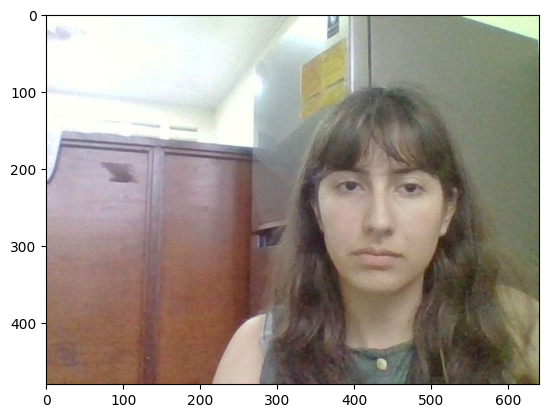

Coordinates: 334 150 196 196 
angry : 0.042872876
disgust : 0.00017620734
fear : 0.09885883
happiness : 0.0032340328
sadness : 0.329755
surprise : 0.0014826109
neutral : 0.5236204


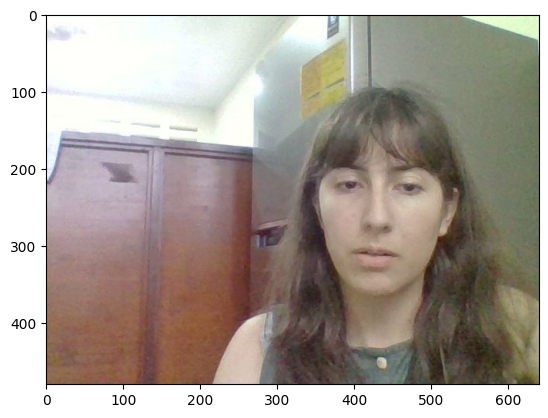

Coordinates: 329 147 202 202 
angry : 0.05817868
disgust : 0.0006632163
fear : 0.1622454
happiness : 0.011053605
sadness : 0.3946951
surprise : 0.0052030385
neutral : 0.367961

Nayarín Zilena Solano Vasquez
208580753
2004/10/05
18
Costa Rican
85227510
female
nz.solano05@gmail.com
100 mts del Aserradero, Alajuela
Single
children: 
number 0
info
Student
100000
University uncompleted
Interviewed


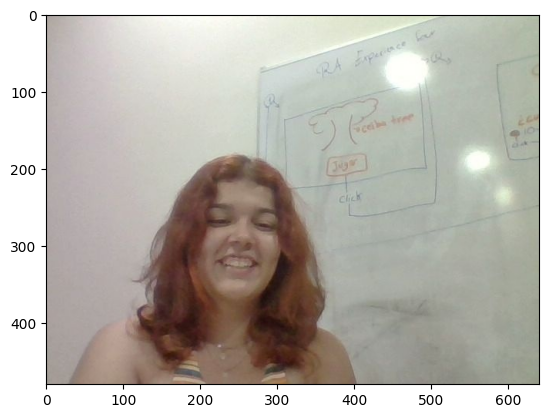

Coordinates: 193 220 128 128 
angry : 0.00043732207
disgust : 7.0315396e-06
fear : 0.0006251849
happiness : 0.9884908
sadness : 0.0015406163
surprise : 0.00030959008
neutral : 0.008589462


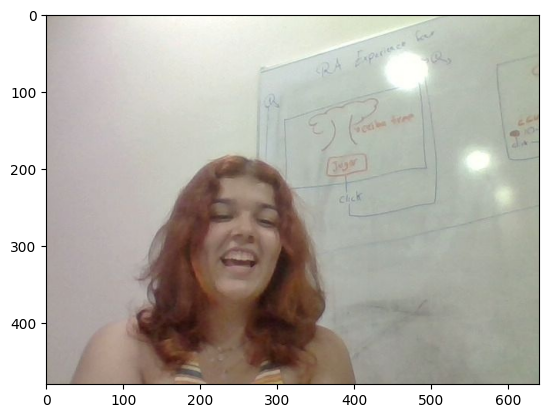

Coordinates: 197 215 125 125 
angry : 0.026210755
disgust : 0.0029591594
fear : 0.059502408
happiness : 0.7597421
sadness : 0.116197914
surprise : 0.0056549767
neutral : 0.029732708


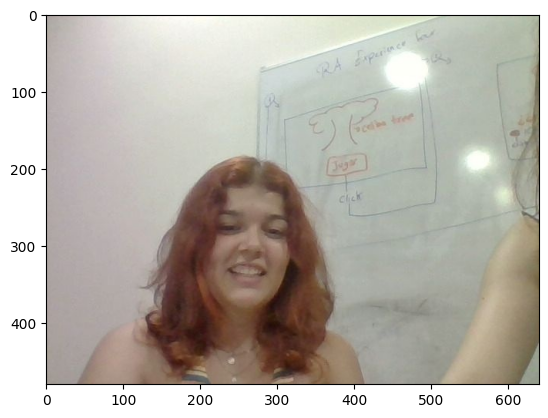

Coordinates: 201 227 135 135 
angry : 0.0011692893
disgust : 1.8147877e-05
fear : 0.0014320682
happiness : 0.9772365
sadness : 0.0025816308
surprise : 0.00090177485
neutral : 0.016660523


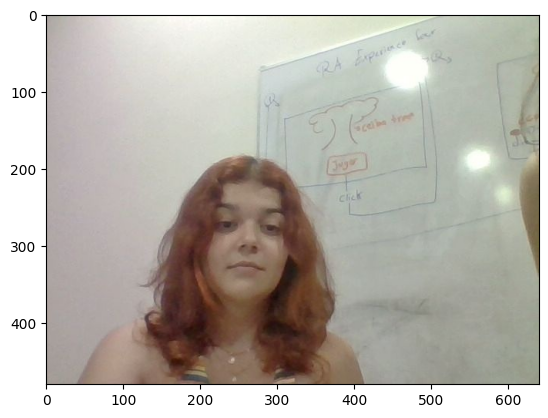

Coordinates: 194 223 138 138 
angry : 0.031156572
disgust : 0.0005421657
fear : 0.02391088
happiness : 0.25622874
sadness : 0.08125325
surprise : 0.0046429653
neutral : 0.6022654


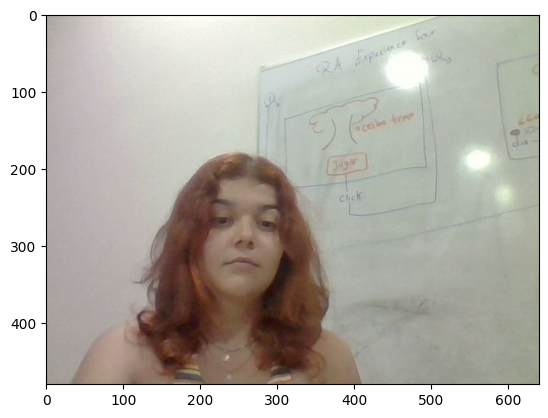

Coordinates: 188 214 141 141 
angry : 0.04716747
disgust : 0.00055534724
fear : 0.03717024
happiness : 0.10898482
sadness : 0.13996193
surprise : 0.003121622
neutral : 0.66303855


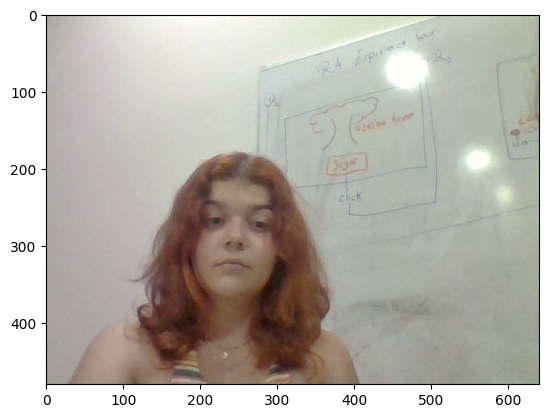

Coordinates: 181 218 135 135 
angry : 0.07094956
disgust : 0.0006197189
fear : 0.095689036
happiness : 0.010084095
sadness : 0.3783751
surprise : 0.0015023345
neutral : 0.4427802


In [94]:
def quicksort(Archive):
    """The function sorts out a list using the quicksort method.
    Arguments:
        Archive {list} -- List of people's instances. 
    Returns:
        list_ {list} -- List of people's instances sorted out based on the amount of children they have.
    """
    list_ = Archive.copy()
    if len(list_) > 0:
        list_ = divide(list_)
        cont = 0
        while cont < len(list_):
            e = list_[cont]
            if type(e) == list:
                if len(e) == 0:
                    del list_[cont]
                elif len(e) == 1:
                    list_[cont] = e[0]
                    cont = cont + 1
                else:
                    list_ = list_[:cont] + divide(e) + list_[cont + 1:]
            else:
                cont = cont + 1
            
    show_info(list_)
quicksort(Archive_interviewee)

[
[

Sharon Blanco Piedra
208500806
2004/02/07
19
Costa Rican
84166154
female
sharoniris889@gmail.com
Zarcero
Single
children: 
number 2
info
female
2010/02/09
female
2005/09/08
Student
0
University uncompleted
Interviewed


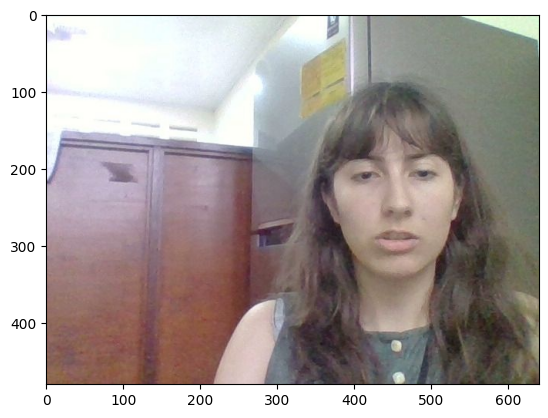

Coordinates: 360 133 190 190 
angry : 0.05418329
disgust : 0.0003852114
fear : 0.13798892
happiness : 0.004647939
sadness : 0.34774035
surprise : 0.0037103035
neutral : 0.45134392


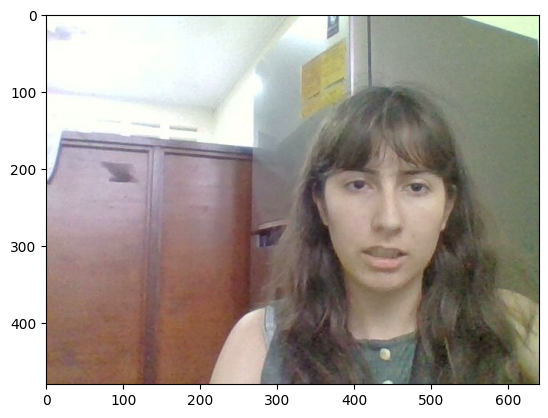

Coordinates: 347 148 194 194 
angry : 0.03821704
disgust : 0.00025661592
fear : 0.08827759
happiness : 0.011761979
sadness : 0.19142021
surprise : 0.0073959325
neutral : 0.6626707


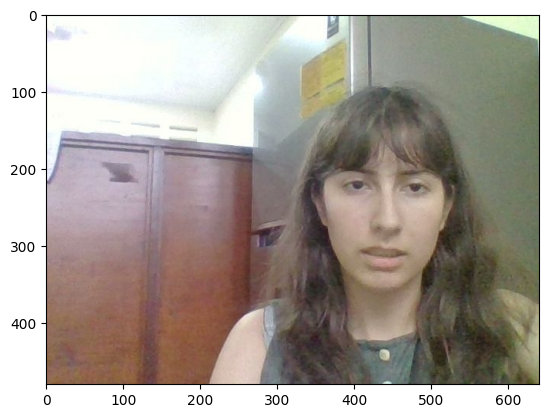

Coordinates: 344 146 197 197 
angry : 0.027986819
disgust : 0.00010510175
fear : 0.05635618
happiness : 0.0072276243
sadness : 0.14875978
surprise : 0.00345685
neutral : 0.7561076


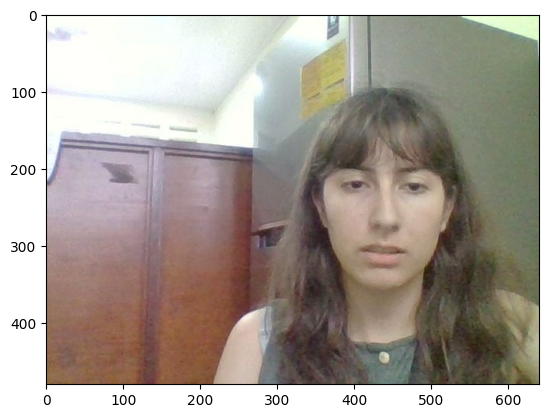

Coordinates: 333 135 212 212 
angry : 0.038025957
disgust : 0.00018448247
fear : 0.099094234
happiness : 0.006433476
sadness : 0.3251961
surprise : 0.0018118734
neutral : 0.52925384


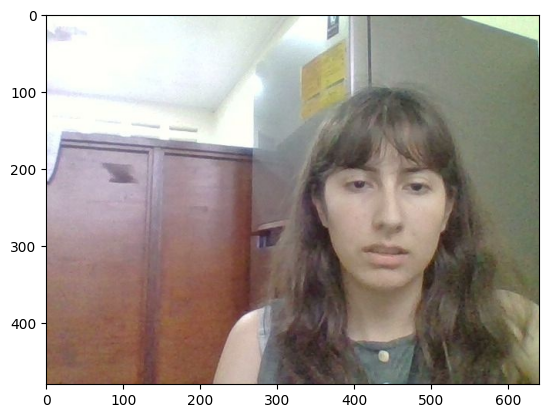

Coordinates: 346 147 198 198 
angry : 0.03838399
disgust : 0.00026997263
fear : 0.08535903
happiness : 0.013804071
sadness : 0.18479683
surprise : 0.0077278307
neutral : 0.66965824


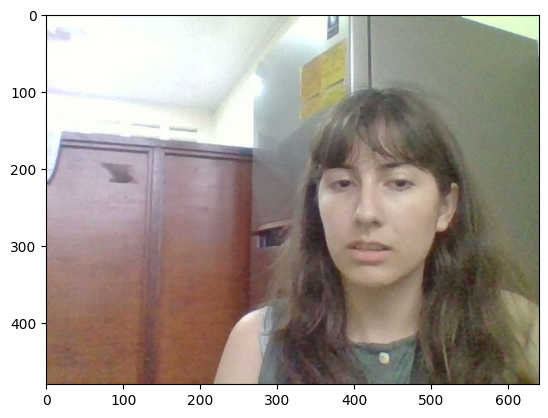

Coordinates: 324 148 190 190 
angry : 0.040059008
disgust : 0.0004804586
fear : 0.18279456
happiness : 0.0059131244
sadness : 0.5617843
surprise : 0.0023823802
neutral : 0.20658617


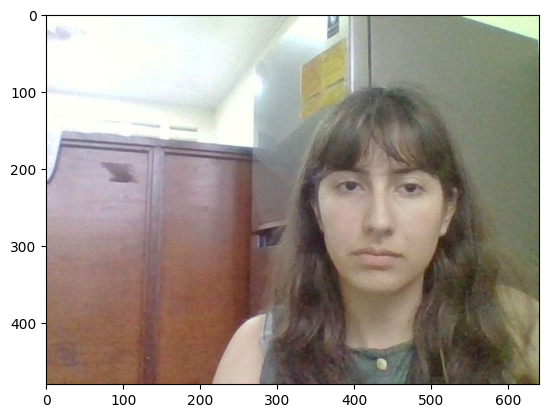

Coordinates: 334 150 196 196 
angry : 0.042872876
disgust : 0.00017620734
fear : 0.09885883
happiness : 0.0032340328
sadness : 0.329755
surprise : 0.0014826109
neutral : 0.5236204


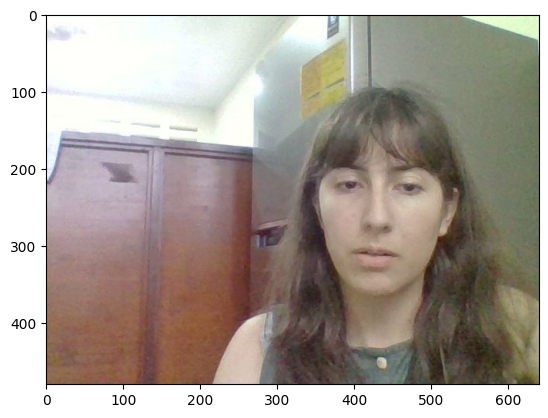

Coordinates: 329 147 202 202 
angry : 0.05817868
disgust : 0.0006632163
fear : 0.1622454
happiness : 0.011053605
sadness : 0.3946951
surprise : 0.0052030385
neutral : 0.367961
]
[]
[]
]


In [95]:
def classify(Archive):
  """The function creates a list with sublists, one with the information of people with only female children, 
  another one with both and the last one with only male children .
    Arguments:
        Archive {list} -- List with all dictionaries.
    Returns:
        checklist {list} -- Classified list.
  """
  male = []
  female = []
  both = []
  for x in Archive:
    if x.children['number'] != 0:
      for i in x.children['info']:
        if i[0] == 'female' and x not in female and x not in male:
            female.append(x)
        if i[0] == "male" and x not in male and x not in female:
          male.append(x)
        if i[0] == "male" and x in female:
          female.remove(x)
          both.append(x)
        if i[0] == "female" and x in male:
          male.remove(x)
          both.append(x)
  check_list = [female, male, both]
  print("[")
  for x in check_list:
    if x == []:
      print(x)
    if x != []:
     print("[")
     show_info(x)
     print("]")
  print("]")
classify(Archive_interviewee)

#Inquiry 5

Obtain for each person the emotions without sorting and save them in a list, with sublists with the ID, the name, the gender, and the age.

In [96]:
def sublists(Archive): 
 """The function creates a list with sublists with specified information.
    Arguments:
        Interviews {list} -- List with all dictionaries.
    Returns:
        generallist {list} -- Classified list.
 """
 generallist = []
 newl = []
 for x in Archive:
   person_lis = []
   person_lis.append(x.identification)
   person_lis.append(x.name)
   person_lis.append(x.gender)
   person_lis.append(x.age)
   emotion_list = []
   for i in x.images:
    for e in i:
     if type(e) == dict:
      emotion_list.append(e)
      
   newl.append(emotion_list)
   newl.insert(0, person_lis)
   generallist.append(newl)
   newl = []

 return generallist
sublists(Archive_interviewee)
  

[[[208500806, 'Sharon Blanco Piedra', 'female', 19],
  [{'angry': 0.05418329,
    'disgust': 0.0003852114,
    'fear': 0.13798892,
    'happiness': 0.004647939,
    'sadness': 0.34774035,
    'surprise': 0.0037103035,
    'neutral': 0.45134392},
   {'angry': 0.03821704,
    'disgust': 0.00025661592,
    'fear': 0.08827759,
    'happiness': 0.011761979,
    'sadness': 0.19142021,
    'surprise': 0.0073959325,
    'neutral': 0.6626707},
   {'angry': 0.027986819,
    'disgust': 0.00010510175,
    'fear': 0.05635618,
    'happiness': 0.0072276243,
    'sadness': 0.14875978,
    'surprise': 0.00345685,
    'neutral': 0.7561076},
   {'angry': 0.038025957,
    'disgust': 0.00018448247,
    'fear': 0.099094234,
    'happiness': 0.006433476,
    'sadness': 0.3251961,
    'surprise': 0.0018118734,
    'neutral': 0.52925384},
   {'angry': 0.03838399,
    'disgust': 0.00026997263,
    'fear': 0.08535903,
    'happiness': 0.013804071,
    'sadness': 0.18479683,
    'surprise': 0.0077278307,
    'ne

#Inquiry 6

Once this list is created, for each person sort the emotion list upwardly based on the emotion happiness.

In [97]:
def divide_list(liss):
    """Arguments:
        liss {list} -- Unsorted list.
    Returns:
        [bigger,pivot,smaller] {list} -- List with sublists with the smaller values, the pivot and the bigger values.
    """
    smaller = []
    bigger = []
    pivot = liss[0]
    for x in liss[1:]:
        if x["happiness"] < pivot["happiness"]:
            smaller.append(x)
        else:
            bigger.append(x) 
    return([smaller, pivot, bigger])

In [98]:
def quickSort(Interviews):
    """The function sorts out a list using the quicksort method.
    Arguments:
        Interviews {list} -- List of people's instances. 
    Returns:
        Interviews {list} -- List of people's instances sorted out based on the emotion happiness.
    """
    if len(Interviews) > 0:
        Interviews = divide_list(Interviews)
        cont = 0
        while cont < len(Interviews):
            e = Interviews[cont]
            if type(e) == list:
                if len(e) == 0:
                    del Interviews[cont]
                elif len(e) == 1:
                    Interviews[cont] = e[0]
                    cont = cont + 1
                else:
                    Interviews = Interviews[:cont] + divide_list(e) + Interviews[cont+1:]
            else:
                cont = cont + 1
            
    return Interviews

In [99]:
def function(Archive):
  Archive_copy = list(Archive)
  for x in Archive_copy:
    x[1] = quickSort(x[1])
  return Archive_copy
o = sublists(Archive_interviewee)
function(o)

[[[208500806, 'Sharon Blanco Piedra', 'female', 19],
  [{'angry': 0.042872876,
    'disgust': 0.00017620734,
    'fear': 0.09885883,
    'happiness': 0.0032340328,
    'sadness': 0.329755,
    'surprise': 0.0014826109,
    'neutral': 0.5236204},
   {'angry': 0.05418329,
    'disgust': 0.0003852114,
    'fear': 0.13798892,
    'happiness': 0.004647939,
    'sadness': 0.34774035,
    'surprise': 0.0037103035,
    'neutral': 0.45134392},
   {'angry': 0.040059008,
    'disgust': 0.0004804586,
    'fear': 0.18279456,
    'happiness': 0.0059131244,
    'sadness': 0.5617843,
    'surprise': 0.0023823802,
    'neutral': 0.20658617},
   {'angry': 0.038025957,
    'disgust': 0.00018448247,
    'fear': 0.099094234,
    'happiness': 0.006433476,
    'sadness': 0.3251961,
    'surprise': 0.0018118734,
    'neutral': 0.52925384},
   {'angry': 0.027986819,
    'disgust': 0.00010510175,
    'fear': 0.05635618,
    'happiness': 0.0072276243,
    'sadness': 0.14875978,
    'surprise': 0.00345685,
    'n

#Inquiry 7

For each person show a graphic to compare the emotions.

Sharon Blanco Piedra


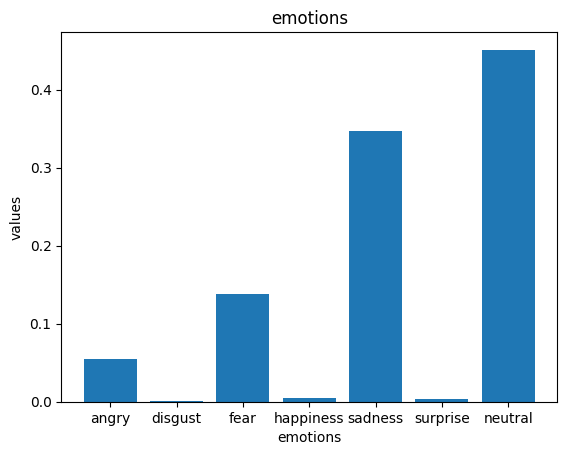

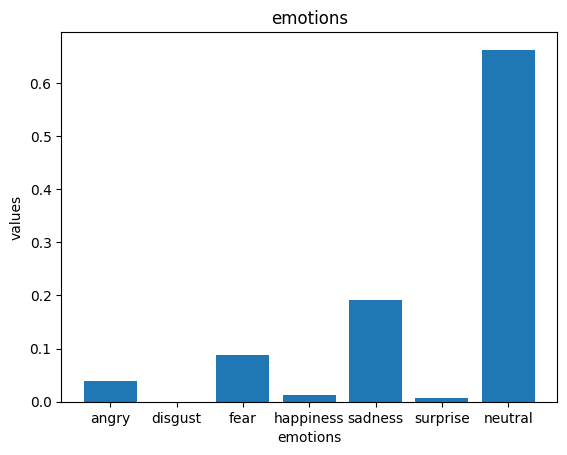

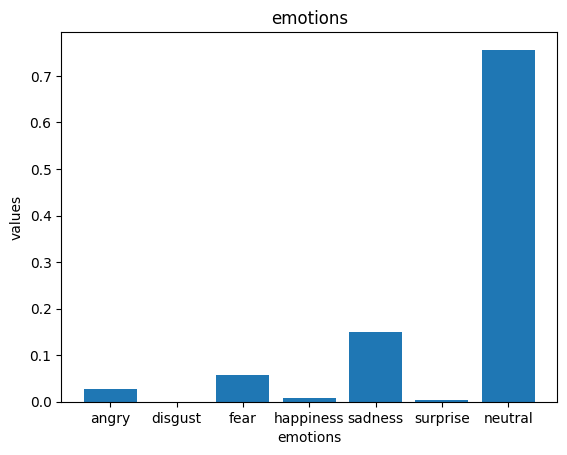

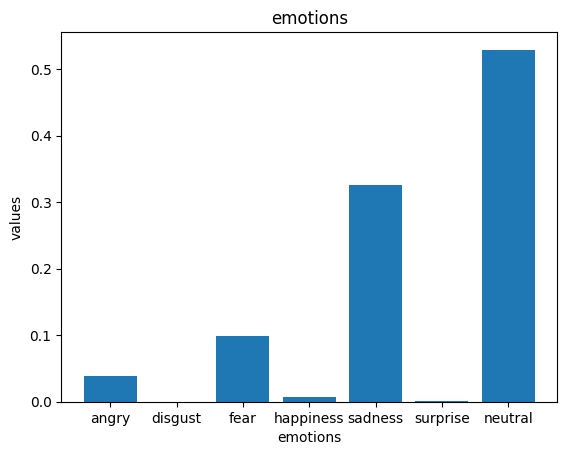

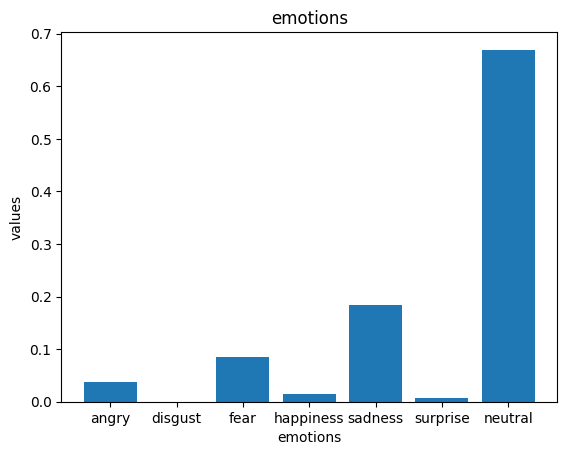

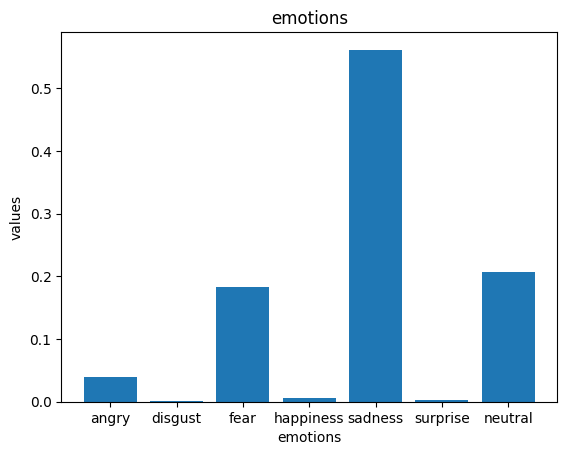

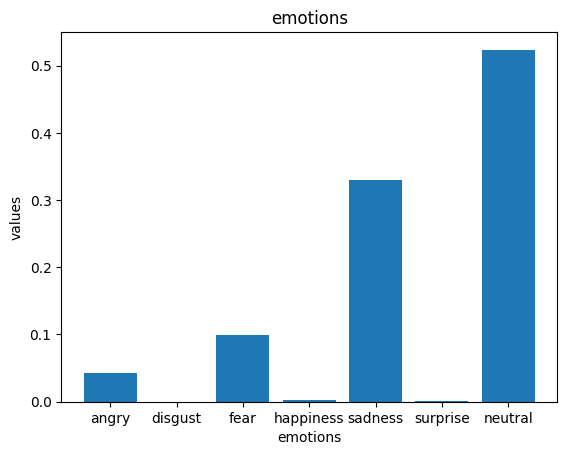

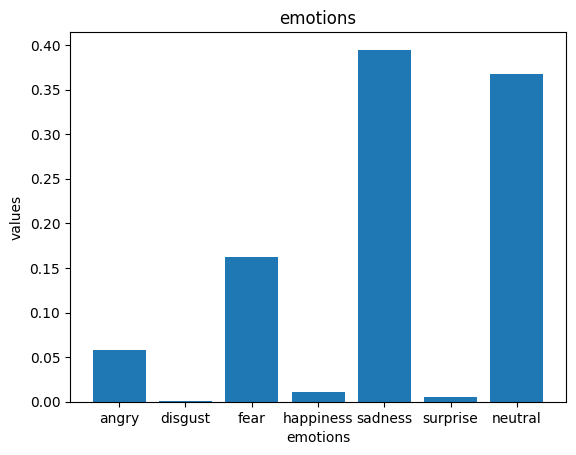

Nayarín Zilena Solano Vasquez


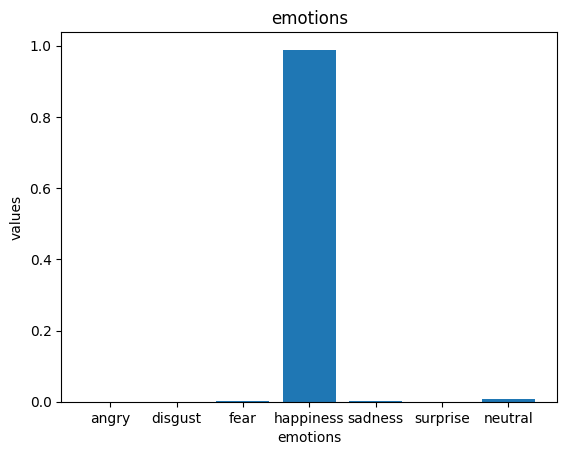

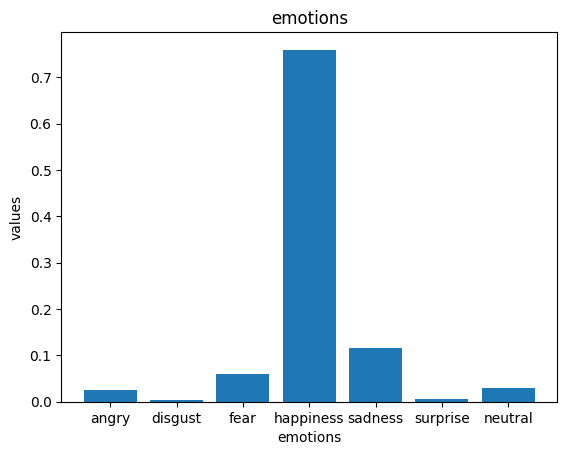

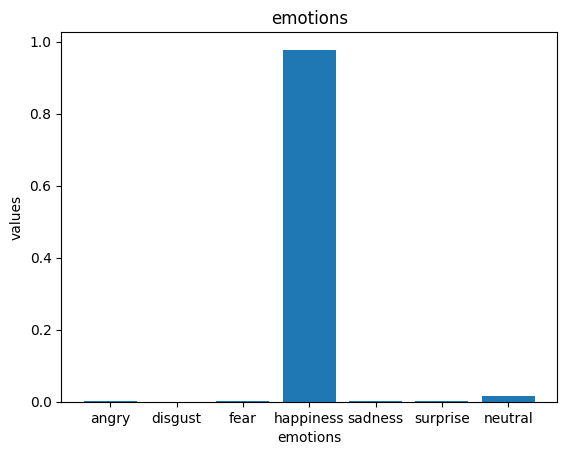

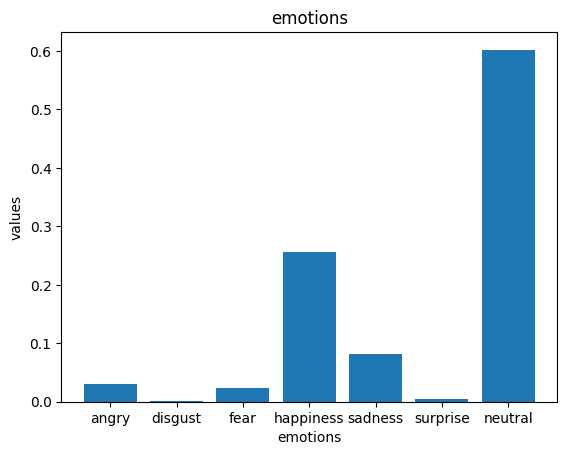

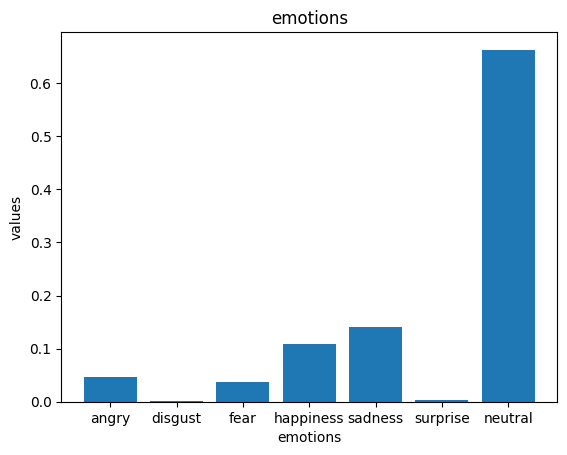

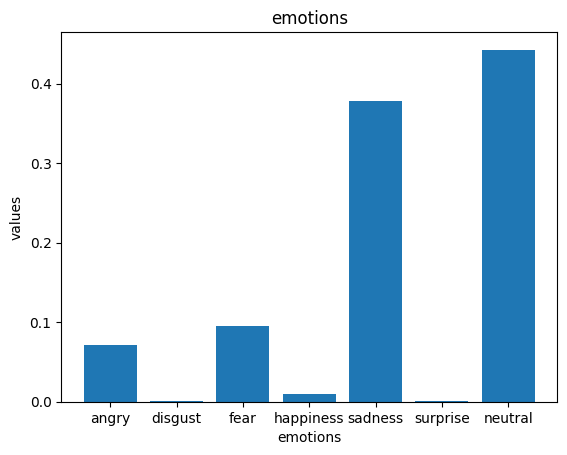

In [100]:
#Library to create a graphic.
import matplotlib.pyplot as plt
#This code access to the emotions dictionaries and creates a graphic for each one of them.
for x in Archive_interviewee:
   c = 0
   print(x.name)
   for i in x.images:
         emotion = i[2]
         names = list(emotion.keys())
         values = list(emotion.values())
         lif, st = plt.subplots()
         st.set_title('emotions')
         st.set_xlabel('emotions')
         st.set_ylabel('values')
         plt.bar(names, values)
         


         plt.show()


#Inquiry 8


Inlcude in the written document the interviews of two people with all information and the information of the interviewer and evaluator.


The information is included in the written document.

#Inquiry 9

Make an interview to a new person or a person that has already been interviewed.



Implemented in the system of the program.

Code to show the information of the archive_evaluator

In [69]:
def show_data(Archive):
  """ This function shows all the information of instances inside a list.
  Arguments:
        Archive {list} -- List with people's instances.
  """

  # Code to export all the information.
  for x in Archive:
    print()
    print(x.name)
    print(x.identification)
    print(x.birth_date)
    print(x.age)
    print(x.nationality)
    for e, y in x.telephone_numbers.items():
      for i in y:
        print(i)
    print(x.gender)
    for i in x.emails:
      print(i)
    print(x.address)
    print(x.specialty)
    print(x.technical_programs)
    print(x.languages)
show_data(Archive_evaluator)


José Joaquín Blanco Rodríguez
203640993
1961/10/29
61
Costa Rican
87803279
female
joseblanco@gmail.com
Zarcero
Accounting
Avix
1


Code to show the information of the archive_interviewer

In [70]:
def show_infor(Archive):
  """ This function shows all the information of instances inside a list.
  Arguments:
        Archive {list} -- List with people's instances.
  """

  # Code to export all the information.
  for x in Archive:
    print()
    print(x.name)
    print(x.identification)
    print(x.birth_date)
    print(x.age)
    print(x.nationality)
    for e, y in x.telephone_numbers.items():
      for i in y:
        print(i)
    print(x.gender)
    for i in x.emails:
      print(i)
    print(x.address)
    print(x.code_number)
    print(x.certificate)
    print(x.experience)
show_infor(Archive_interviewer)


Lorena Piedra Madrigal
204030421
1965/02/20
58
Costa Rican
85659494
86454320
female
Lorenapiedra@gmail.com
Zarcero
267876
35262
10


#Inquiry 10

Add an evaluation to validate if the person will be hired or not, the person must have a property called state that dictates the state of the interview and the evaluator can change it.



In [101]:
def show_individualinformation(x):
    """ This function shows all the information of an instance.
    Arguments:
        Archive {list} -- List with people's instances.
    """
    print()
    print(x.name)
    print(x.identification)
    print(x.birth_date)
    print(x.age)
    print(x.nationality)
    for e, y in x.telephone_numbers.items():
      for i in y:
        print(i)
    print(x.gender)
    for i in x.emails:
      print(i)
    print(x.address)
    print(x.marital_status)
    print("children: ")
    for j, p in x.children.items():
      if j == "info":
        print(j)
        for k in p:
          for y in k:
            print(y)
      else:
        print(j, p)
    print(x.job)
    print(x.salary)
    print(x.academic_grade)
    print(x.state)
    for x in x.images:
        show_image(x[0])
        p = x[1][0][0]
        print("Coordinates: ", end= '')
        for e in p:
          print(e, end=' ')
        print()
        for w, y  in x[2].items():
          print(w, ":", y)

Interviews validation
Write the ID of the interviewed person that is going to be evaluated: 
208500806

Sharon Blanco Piedra
208500806
2004/02/07
19
Costa Rican
84166154
female
sharoniris889@gmail.com
Zarcero
Single
children: 
number 2
info
female
2010/02/09
female
2005/09/08
Student
0
University uncompleted
Interviewed


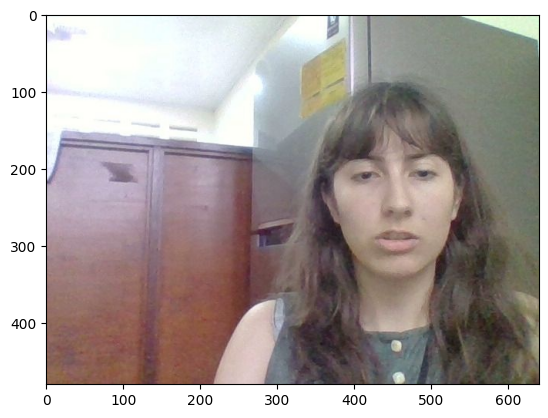

Coordinates: 360 133 190 190 
angry : 0.05418329
disgust : 0.0003852114
fear : 0.13798892
happiness : 0.004647939
sadness : 0.34774035
surprise : 0.0037103035
neutral : 0.45134392


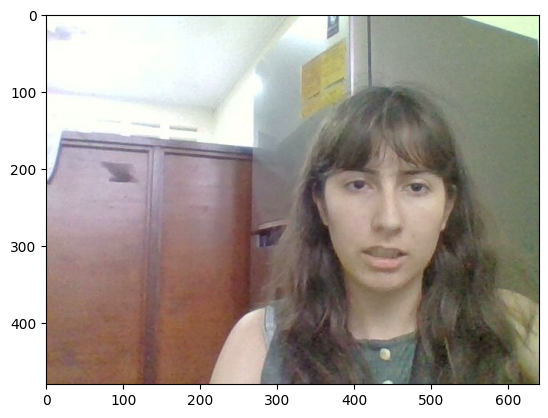

Coordinates: 347 148 194 194 
angry : 0.03821704
disgust : 0.00025661592
fear : 0.08827759
happiness : 0.011761979
sadness : 0.19142021
surprise : 0.0073959325
neutral : 0.6626707


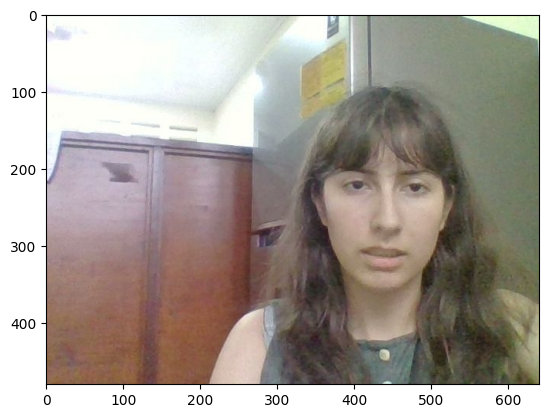

Coordinates: 344 146 197 197 
angry : 0.027986819
disgust : 0.00010510175
fear : 0.05635618
happiness : 0.0072276243
sadness : 0.14875978
surprise : 0.00345685
neutral : 0.7561076


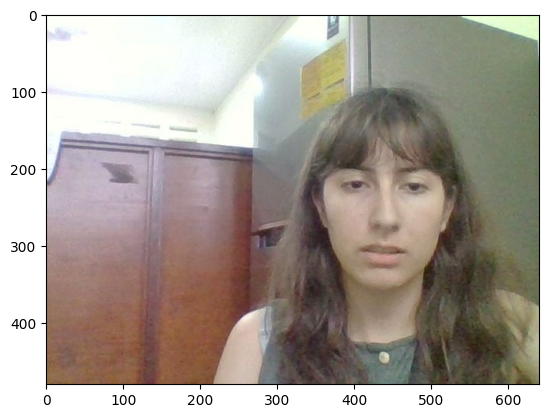

Coordinates: 333 135 212 212 
angry : 0.038025957
disgust : 0.00018448247
fear : 0.099094234
happiness : 0.006433476
sadness : 0.3251961
surprise : 0.0018118734
neutral : 0.52925384


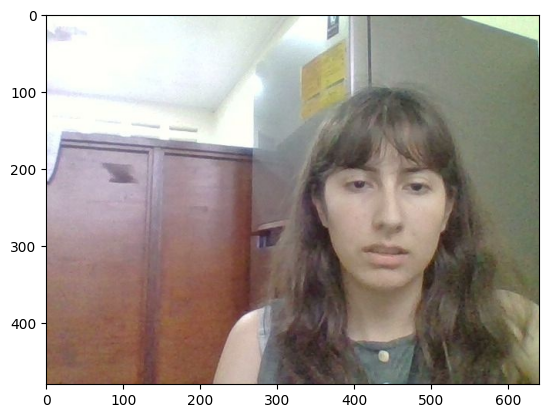

Coordinates: 346 147 198 198 
angry : 0.03838399
disgust : 0.00026997263
fear : 0.08535903
happiness : 0.013804071
sadness : 0.18479683
surprise : 0.0077278307
neutral : 0.66965824


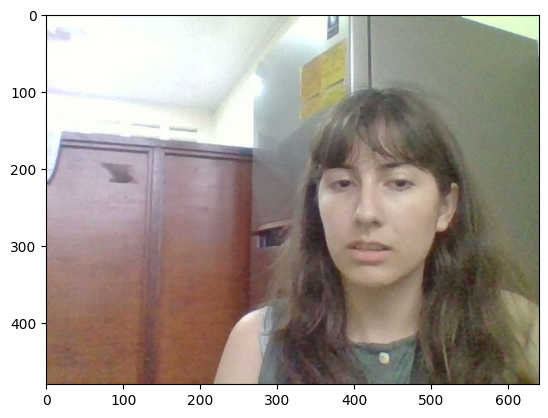

Coordinates: 324 148 190 190 
angry : 0.040059008
disgust : 0.0004804586
fear : 0.18279456
happiness : 0.0059131244
sadness : 0.5617843
surprise : 0.0023823802
neutral : 0.20658617


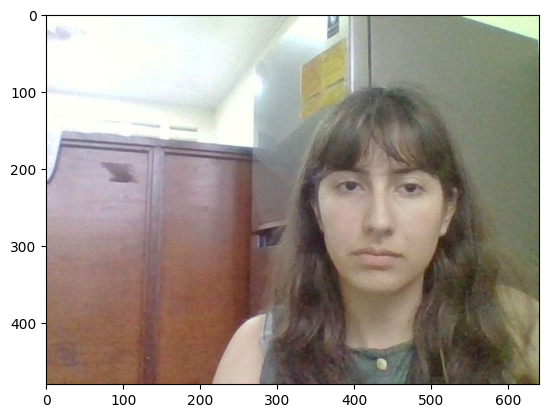

Coordinates: 334 150 196 196 
angry : 0.042872876
disgust : 0.00017620734
fear : 0.09885883
happiness : 0.0032340328
sadness : 0.329755
surprise : 0.0014826109
neutral : 0.5236204


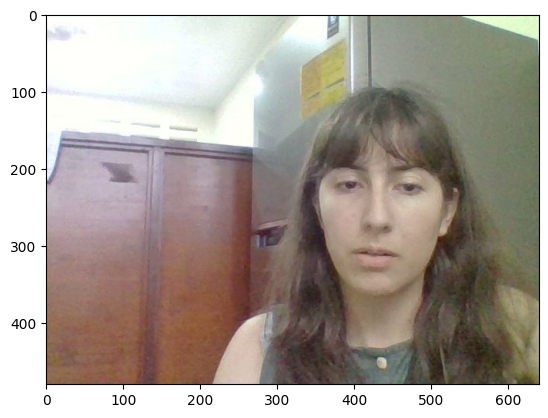

Coordinates: 329 147 202 202 
angry : 0.05817868
disgust : 0.0006632163
fear : 0.1622454
happiness : 0.011053605
sadness : 0.3946951
surprise : 0.0052030385
neutral : 0.367961
Write the new stage of the interview
IntervieweD
The state of the individual's interview has changed


In [102]:
#Code to change the state of validation of an instance.
print("Interviews validation")
print("Write the ID of the interviewed person that is going to be evaluated: ")
m = int(input())
for x in Archive_interviewee:
  if x.identification == m:
    show_individualinformation(x)
    print("Write the new stage of the interview")
    state = input()
    x.state = state
    print("The state of the individual's interview has changed")
    with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistado", "wb") as entre:
      pickle.dump(Archive_interviewee, entre) 
    

In [103]:
#Library pickle to save archives.
import pickle
#Code to read the information of the archives.
with open("/content/drive/MyDrive/Binary_archive/Archivo_Evaluador", "rb") as entre:
    Archive_evaluator = pickle.load(entre)
for x in Archive_evaluator:
  print(x)
with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistador", "rb") as entre:
  Archive_interviewer = pickle.load(entre)
for x in Archive_interviewer:
    print(x)
with open("/content/drive/MyDrive/Binary_archive/Archivo_Entrevistado", "rb") as entre:
  Archive_interviewee = pickle.load(entre)
print("---------")
for x in Archive_interviewee:
  print(x)

name: José Joaquín Blanco Rodríguez, identitification: 203640993, birth_date: 1961/10/29, age: 61, nationality: Costa Rican, telephone_numbers: {'telephone_number': [87803279]}, gender: male, emails: ['joseblanco@gmail.com'], address: Zarcero, specialty: Accounting, technical_programs: Avix, languages: 1
name: Lorena Piedra Madrigal, identitification: 204030421, birth_date: 1965/02/20, age: 58, nationality: Costa Rican, telephone_numbers: {'telephone_number': [86569494, 86454320]}, gender: female, emails: ['Lorenapiedra@gmail.com'], address: Zarcero, code_number: 267876, certificate: 35262, experience: 10
---------
name: Sharon Blanco Piedra, identitification: 208500806, birth_date: 2004/02/07, age: 19, nationality: Costa Rican, telephone_numbers: {'telephone_number': [84166154]}, gender: female, emails: ['sharoniris889@gmail.com'], address: Zarcero, marithal_status: Single, children: {'number': 2, 'info': [['female', '2010/02/09'], ['female', '2005/09/08']]}, job: Student, salary: 0, 

#Images

https://drive.google.com/drive/folders/1zR_-H_EZe8a5_59nz8Lrdd4zcpMsbfFI?usp=sharing

# Consultas


1.   Mostrar la información de todas las personas entrevistas (la información debe ser mostrada siendo saca del archivo correspondiente, debe mostrar la información en formato legible, no en estructuras y objetos). Además, debe mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros.

2.   Mostrar la información de todas las personas entrevistas ordenada ascendentemente por edad. El método de ordenamiento a utilizar es el método por inserción (la información debe ser mostrada siendo saca de los archivos, no se debe hacer simplemente la impresión en pantalla de la información obtenida de los archivos). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros.

3.   Mostrar la información de todas las personas entrevistas ordenada descendente mente por la cantidad de hijos. El método de ordenamiento a utilizar es el método por de la bubuja (la información debe ser mostrada siendo saca de los archivos, no se debe hacer simplemente la impresión en pantalla de la información obtenida de los archivos). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros.

4. Mostrar la información de todas las personas entrevistas ordenada descendentemente por la cantidad de hijos. El método de ordenamiento a utilizar es el método por de la quicksort (la información debe ser mostrada siendo sacada de los archivos, no se debe hacer simplemente la impresión en pantalla de la información obtenida de los archivos). Además, de mostrar toda la información recolectada de la persona, se debe mostrar todas las imágenes que se recolectaron durante las entrevistas, las emociones reconocidas para cada imagen y las coordenadas donde se encuentra los rostros. También, imprimir una lista con sublistas donde la primera sublista tiene la información de las personas que tienen únicamente hijos de género femenino, la segunda sublista tiene información de personas que tienen únicamente hijos de género masculino y la última sublista tiene información de personas que tienen hijos tanto de género femenino como másculino. 

5. Obtener para cada persona entrevistada las emociones sin ordenar y guardar en una lista (una lista por entrevista) con sublistas la siguiente información: en la primera sublista colocar la identificación, el nombre, el género y la edad de la persona entrevistada, en las siguientes sublistas colocar las emociones expresadas por la persona. Por ejemplo, si la persona apareció en 10 fotogramas entonces se deben crear 10 sublistas, cada sublista pertenece a las emociones emitidas por el candidato en un fotograma. 

6. Una vez creada esta listas (una por entrevista) con sublistas del punto anterior, se debe ordenar las sublistas de forma ascendente por la emoción felicidad (happiness) utilizando el técnica de ordenamiento Quicksort.

7. Para cada persona entrevistada muestre un gráfico para comparar las emociones reportadas durante la entrevista.

8. Incluya en el documento escrito la entrevista a dos personas. De aportar toda la información recolectada, las imágenes recolectadas en la entrevista con un cuadro en los rostros presentes. Además, debe mostrar la información de las emociones reportadas. También debe mostrar la información del entrevistador y el evaluador.

9. Hacer una nueva entrevista a una persona. Una persona existente (previamente almacena en los archivos) puede volver a ser entrevistada. Debe guardar la nueva entrevista en el mismo archivo agregando la información de esta nueva entrevista a la lista de entrevistas de dicha persona. Tome en cuenta que el entrevistador puede ser uno que no le ha realizado ninguna entrevista.

10. Agregar una evaluación para indicar si la persona será contratada. Una vez que una persona ha sido entrevistada un evaluador puede revisar toda la información y decir si la persona será contratada (Debe mostrar la información de la persona para que el evaluador la revise y debe aportar una propiedad para la persona que se indica llamada "estado" (el estado puede ser entrevistado, contratado y no contratado). Tome en cuenta que el evaluador puede cambiar el estado de la persona para indicar que está contratado o no contratado. 




## Aspectos administrativos


* La tarea será desarrollada en equipos de trabajo de máximo 2 personas.
* Cualquier acción de plagio será sancionada con una nota de 0 y la carta al expediente respectiva para todos los
implicados.
* La fecha de entrega será la semana 14, el día de clases, antes de la hora de clases.
* Para llevar el control de versiones del proyecto se debe crear un repositorio en GitLab y agregar al profesor (agregarlo
a la cuenta amendez.tec@gmail.com).
* Para llevar el control del las tareas a realizar por participante en el proyecto debe utilizar la herramienta
https://trello.com/es y compartir el link en el mismo Google Doc en que se comparte el link de la plantilla de Overleaf. Pueden crear tab de todas las tareas o requerimientos, un tab para las tareas en proceso y un tab para las tareas hechas.
* La codificación y documentación interna deberá ser desarrollada en idioma inglés utilizando el estándar docString de Python.
*La documentación externa debe estar redactada en idioma inglés utilizando la herramienta Overleaf (utilizar la plantilla facilitada por el profesor). La documentación es evaluada en el curso de Introducción a la programación.
* Documentación del Código utilizando Docstring Conventions 	
* Introducción a Python la Guía de Estilo de Código en Python
* La entrega será mediante la plataforma TecDigital en el espacio de Proyecto – Etapa 2. Lo que debe subir es un archivo de tipo notebook cuya extensión es (.ipynb). Además, en este archivo deben venir los enlaces a las imagenes utilizados para la tarea.
* Se recomienda que se empiece a trabajar lo antes posible.



# "La programación es una habilidad que puedes cultivar en ti mismo y usar para cambiar el mundo". - Barack Obama